# first

In [ ]:
import torch
import torch.nn as nn
from skimage import io
import skimage

In [ ]:
# prompt: clone https://github.com/face-analysis/emonet.git in /content/

!git clone https://github.com/face-analysis/emonet.git /content/emonet


Cloning into '/content/emonet'...
remote: Enumerating objects: 106, done.
remote: Counting objects: 100% (19/19), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 106 (delta 15), reused 13 (delta 13), pack-reused 87
Receiving objects: 100% (106/106), 100.00 MiB | 34.33 MiB/s, done.
Resolving deltas: 100% (42/42), done.
Updating files: 100% (17/17), done.


In [ ]:
# prompt: rec delete /content/SPIGA/emonet

!rm -rf /content/emonet


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import zipfile

# Specify the path to your ZIP file and the destination directory where you want to extract the contents
zip_file_path = '/content/drive/MyDrive/emonet-master.zip'
destination_directory = './'

# Open the ZIP file for reading
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Extract all the contents to the destination directory
    zip_ref.extractall(destination_directory)

print(f"Successfully unzipped '{zip_file_path}' to '{destination_directory}'")


Successfully unzipped '/content/drive/MyDrive/emonet-master.zip' to './'


In [ ]:
import os
os.chdir('/content/emonet-master')

In [ ]:
os.getcwd()

'/content/emonet-master'

In [ ]:
from emonet.models import EmoNet
import torch
n_expression=5
batch_size = 1
n_workers = 16
image_size = 256
device = 'cuda:0'
state_dict_path =f'/content/emonet-master/pretrained/emonet_{n_expression}.pth'
print(f'Loading the model from {state_dict_path}.')
state_dict = torch.load(str(state_dict_path), map_location='cpu')
state_dict = {k.replace('module.',''):v for k,v in state_dict.items()}
net = EmoNet(n_expression=n_expression).to(device)
net.load_state_dict(state_dict, strict=False)


Loading the model from /content/emonet-master/pretrained/emonet_5.pth.


<All keys matched successfully>

In [ ]:
from torchvision import transforms
from emonet.data_augmentation import DataAugmentor
import numpy as np
transform_image = transforms.Compose([transforms.ToTensor()])
transform_image_shape_no_flip = DataAugmentor(image_size, image_size)
image_np = io.imread('/content/t1.jpg')
image_height, image_width, _ = image_np.shape
bounding_box = [0, 0, image_width, image_height]
image1, _ = transform_image_shape_no_flip(image_np, bb=bounding_box)
image2 = np.ascontiguousarray(image1)
image3 = transform_image(image2)
# image2 = np.ascontiguousarray(image_np)
# image3 = transform_image(image2)


In [ ]:
# prompt: zip output folder

!zip -r output.zip output


  adding: output/ (stored 0%)
  adding: output/frame_frame_24.0_sec/ (stored 0%)
  adding: output/frame_frame_24.0_sec/face_face_0.png (deflated 2%)
  adding: output/frame_frame_24.0_sec/frame_frame_24.0_sec.png (deflated 1%)
  adding: output/frame_frame_24.0_sec/face_face_1.png (deflated 2%)
  adding: output/frame_frame_40.0_sec/ (stored 0%)
  adding: output/frame_frame_40.0_sec/face_face_0.png (deflated 2%)
  adding: output/frame_frame_40.0_sec/frame_frame_40.0_sec.png (deflated 1%)
  adding: output/frame_frame_40.0_sec/face_face_1.png (deflated 2%)
  adding: output/frame_frame_13.0_sec/ (stored 0%)
  adding: output/frame_frame_13.0_sec/frame_frame_13.0_sec.png (deflated 1%)
  adding: output/frame_frame_13.0_sec/face_face_0.png (deflated 2%)
  adding: output/frame_frame_13.0_sec/face_face_1.png (deflated 2%)
  adding: output/frame_frame_22.0_sec/ (stored 0%)
  adding: output/frame_frame_22.0_sec/frame_frame_22.0_sec.png (deflated 1%)
  adding: output/frame_frame_22.0_sec/face_face_0.

In [ ]:
image3

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]],

        [[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]])

In [ ]:
from torch.utils.data import DataLoader
image=image3.to(device)
batch_image = image.unsqueeze(0)
net.eval()
with torch.no_grad():
  out = net(batch_image)


In [ ]:
out.keys()

dict_keys(['heatmap', 'expression', 'valence', 'arousal'])

In [ ]:
exp=np.argmax(out['expression'].cpu()[0])


In [ ]:

emotions=['Neutral','Happy','Sad','Surprise','Fear','Disgust','Anger','Contempt']
print(emotions[exp])

Happy


In [ ]:
lm=out['heatmap'].cpu()[0]

In [ ]:
print(out['valence'].cpu()[0],out['arousal'].cpu()[0])

tensor(-0.1949) tensor(0.4617)


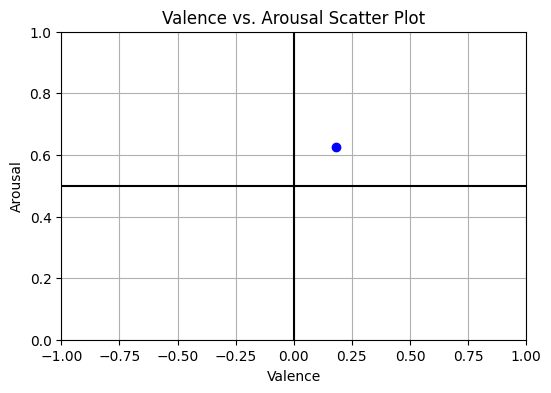

In [ ]:
import matplotlib.pyplot as plt

# Assuming you have valence and arousal values
valence = out['valence'].cpu()[0]
arousal = out['arousal'].cpu()[0]

# Normalize valence to the range -1 to 1
normalized_valence = (valence + 1) / 2

# Create a scatter plot
plt.figure(figsize=(6, 4))
plt.scatter([normalized_valence], [arousal], c='blue', marker='o')
plt.xlim(-1, 1)
plt.ylim(0, 1)

# Add labels and title
plt.xlabel('Valence')
plt.ylabel('Arousal')
plt.title('Valence vs. Arousal Scatter Plot')

# Add axes lines with clear color
plt.axhline(y=0.5, color='black')
plt.axvline(x=0, color='black')

plt.grid(True)
plt.show()


In [ ]:
lm[0]

tensor([[ 4.9746e-05,  9.5681e-05,  1.0169e-04,  ...,  5.6478e-05,
          3.1872e-05, -6.8040e-06],
        [ 3.8412e-05,  9.8960e-05,  1.0633e-04,  ...,  5.0413e-05,
          4.0739e-05,  3.1767e-06],
        [ 1.7449e-05,  5.2376e-05,  5.5048e-05,  ...,  1.7052e-05,
          4.4862e-05,  1.8553e-06],
        ...,
        [ 9.1026e-05,  1.3114e-04,  1.0856e-04,  ...,  2.3187e-05,
          4.7372e-05, -3.0701e-05],
        [ 1.1093e-04,  1.5450e-04,  1.2114e-04,  ...,  2.8465e-06,
          3.3532e-05, -3.2677e-06],
        [ 5.9174e-05,  9.6316e-05,  7.9287e-05,  ..., -5.4631e-05,
         -1.5402e-05, -4.1989e-05]])

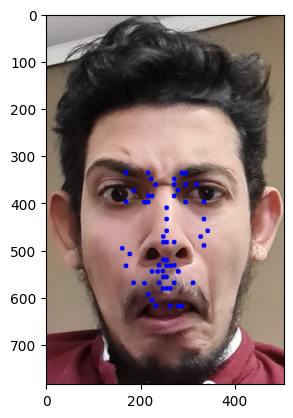

In [ ]:
import cv2
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import numpy as np

# Load the image
image = cv2.imread('/content/fear.jpg')

# Your shape tensor
landmarks = lm  # Replace 'lm' with your actual landmarks tensor

# Load the image (replace 'your_image_path.jpg' with the actual image path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Create an empty canvas to hold all overlays
overlay_canvas = image_rgb.copy()

# Define a transformation to resize the heatmap to the image size
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((image.shape[0], image.shape[1])),
    transforms.ToTensor()
])

# Plot the most heated point in each resized heatmap
for heatmap in landmarks:
    # Resize the heatmap to match the image size
    heatmap_resized = transform(heatmap)[0]

    # Find the position (x, y) of the maximum value in the resized heatmap
    x, y = torch.argmax(heatmap_resized.view(-1)).item() % image.shape[1], torch.argmax(heatmap_resized.view(-1)).item() // image.shape[1]

    # Draw a red dot at the most heated point
    cv2.circle(overlay_canvas, (x, y), 5, (0, 0, 255), -1)  # 5 is the radius, (0, 0, 255) is red

# Show the image with red dots at the most heated points
plt.imshow(overlay_canvas)
plt.show()


In [ ]:
lm[0].shape

torch.Size([64, 64])

In [ ]:
from emonet.models import EmoNet
import torch
import cv2
import numpy as np
from emonet.data_augmentation import DataAugmentor
from torchvision import transforms

n_expression = 8
image_size = 256
device = 'cuda:0'
state_dict_path = '/content/emonet-master/pretrained/emonet_{}.pth'.format(n_expression)
print('Loading the model from {}.'.format(state_dict_path))
state_dict = torch.load(state_dict_path, map_location='cpu')
state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
net = EmoNet(n_expression=n_expression).to(device)
net.load_state_dict(state_dict, strict=False)

transform_image = transforms.Compose([transforms.ToTensor()])
transform_image_shape_no_flip = DataAugmentor(image_size, image_size)

emotions = ['Neutral', 'Happy', 'Sad', 'Surprise', 'Fear', 'Disgust', 'Anger', 'Contempt']

# Create a VideoCapture object to capture frames from your webcam or video file.
# For webcam, you can use: cv2.VideoCapture(0)
# For a video file, provide the file path: cv2.VideoCapture('your_video.mp4')
cap = cv2.VideoCapture('/content/vm.mp4')

# Define the codec and create a VideoWriter object to save the video.
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out_video = cv2.VideoWriter('/content/drive/MyDrive/output.avi', fourcc, 20.0, (640, 480))  # Adjust frame size and frame rate as needed.

while True:
    ret, frame = cap.read()

    if not ret:
        break

    image_height, image_width, _ = frame.shape
    bounding_box = [0, 0, image_width, image_height]

    transform = transforms.Compose([
        DataAugmentor(image_size, image_size),
        transforms.ToTensor()
    ])

    image, _ = transform_image_shape_no_flip(frame, bb=bounding_box)
    image = np.ascontiguousarray(image)
    image = transform_image(image)
    image = image.to(device).unsqueeze(0)

    net.eval()
    with torch.no_grad():
        out = net(image)
    exp = np.argmax(out['expression'].cpu()[0])

    emotion = emotions[exp]

    # Display the emotion prediction on the frame.
    cv2.putText(frame, "Emotion: {}".format(emotion), (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    # Write the frame to the output video.
    out_video.write(frame)

# Release the VideoCapture, VideoWriter, and close the OpenCV window.
cap.release()
out_video.release()
cv2.destroyAllWindows()


Loading the model from /content/emonet-master/pretrained/emonet_8.pth.


In [ ]:
from emonet.models import EmoNet
import torch
import cv2
import numpy as np
from emonet.data_augmentation import DataAugmentor
from torchvision import transforms

n_expression = 8
image_size = 256
device = 'cuda:0'
state_dict_path = '/content/emonet-master/pretrained/emonet_{}.pth'.format(n_expression)
print('Loading the model from {}.'.format(state_dict_path))
state_dict = torch.load(state_dict_path, map_location='cpu')
state_dict = {k.replace('module.', ''): v for k, v in state_dict.items()}
net = EmoNet(n_expression=n_expression).to(device)
net.load_state_dict(state_dict, strict=False)

transform_image = transforms.Compose([transforms.ToTensor()])
transform_image_shape_no_flip = DataAugmentor(image_size, image_size)

emotions = ['Neutral', 'Happy', 'Sad', 'Surprise', 'Fear', 'Disgust', 'Anger', 'Contempt']

# Create a VideoCapture object to capture frames from your webcam or video file.
# For webcam, you can use: cv2.VideoCapture(0)
# For a video file, provide the file path: cv2.VideoCapture('your_video.mp4')
cap = cv2.VideoCapture('/content/vm.mp4')

# Define the codec and create a VideoWriter object to save the video.
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out_video = cv2.VideoWriter('/content/drive/MyDrive/output.avi', fourcc, 20.0, (640, 480))  # Adjust frame size and frame rate as needed.

while True:
    ret, frame = cap.read()

    if not ret:
        break

    image_height, image_width, _ = frame.shape
    bounding_box = [0, 0, image_width, image_height]

    transform = transforms.Compose([
        DataAugmentor(image_size, image_size),
        transforms.ToTensor()
    ])

    image, _ = transform_image_shape_no_flip(frame, bb=bounding_box)
    image = np.ascontiguousarray(image)
    image = transform_image(image)
    image = image.to(device).unsqueeze(0)

    net.eval()
    with torch.no_grad():
        out = net(image)
    exp = np.argmax(out['expression'].cpu()[0])

    emotion = emotions[exp]

    # Display the emotion prediction on the frame.
    cv2.putText(frame, "Emotion: {}".format(emotion), (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    # Write the frame to the output video.
    out_video.write(frame)

# Release the VideoCapture and VideoWriter.
cap.release()
out_video.release()

# View the saved video using an external video player.
print("Video processing is complete. You can now view the saved video.")


Loading the model from /content/emonet-master/pretrained/emonet_8.pth.
Video processing is complete. You can now view the saved video.


In [ ]:
import cv2

# Open the saved video file.
video_capture = cv2.VideoCapture('output.avi')

while True:
    ret, frame = video_capture.read()

    if not ret:
        break

    # Display the frame.
    cv2.imshow('Emotion Detection Video', frame)

    # Break the loop when 'q' is pressed or the video ends.
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the video player.
video_capture.release()

# Close the OpenCV window.
cv2.destroyAllWindows()


# test video

In [ ]:
import cv2
import os

def capture_frames(video_path, output_folder, fps=1):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Open the video file
    video = cv2.VideoCapture(video_path)

    # Get the frames per second of the video
    video_fps = video.get(cv2.CAP_PROP_FPS)

    # Calculate the frame skip value
    frame_skip = int(video_fps / fps)

    frame_count = 0
    while True:
        ret, frame = video.read()
        if not ret:
            break

        # If this is the frame to save
        if frame_count % frame_skip == 0:
            # Calculate the second of the video
            second = frame_count // video_fps
            # Save the frame to the output folder
            cv2.imwrite(os.path.join(output_folder, f'frame_{second}_sec.jpg'), frame)

        frame_count += 1

    video.release()

# Usage
capture_frames('/content/CAR CRASH CAUGHT ON GOPRO.mp4', 'output_folder1')


# sec

In [ ]:
!pip install -U insightface
!pip install onnxruntime
# Clone and setup the repository
!pip install spiga
!git clone https://github.com/face-analysis/emonet.git /content/emonet
%cd SPIGA/
!pip install -e .
!pip install pickle


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 439.5/439.5 kB 5.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 87.3 MB/s eta 0:00:00
  Created wheel for insightface: filename=insightface-0.7.3-cp310-cp310-linux_x86_64.whl size=1054320 sha256=8418845ad53ba5219f8151c88691734e3686c7f4cf803cf154e754ec93b5e617
  Stored in directory: /root/.cache/pip/wheels/e3/d0/80/e3773fb8b6d1cca87ea1d33d9b1f20a223a6493c896da249b5
Successfully built insightface
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.4/6.4 MB 56.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.2/95.2 kB 2.1 MB/s eta 0:00:00
Cloning into '/content/emon

In [ ]:
import cv2
import numpy as np
import insightface
from insightface.app import FaceAnalysis
from insightface.data import get_image as ins_get_image
import cv2
import json
import numpy as np
from google.colab.patches import cv2_imshow
from spiga.inference.config import ModelConfig
from spiga.inference.framework import SPIGAFramework
import copy
from spiga.demo.visualize.plotter import Plotter
import matplotlib.pyplot as plt
import os
import json
import math
import copy
import numpy as np
import cv2
import torch
import torch.nn as nn
from skimage import io
import skimage
from emonet.emonet.models import EmoNet
from torchvision import transforms
from emonet.emonet.data_augmentation import DataAugmentor
import pickle

In [ ]:
import cv2
import numpy as np
import insightface
from insightface.app import FaceAnalysis
from insightface.data import get_image as ins_get_image
import cv2
import json
import numpy as np
from google.colab.patches import cv2_imshow
from spiga.inference.config import ModelConfig
from spiga.inference.framework import SPIGAFramework
import copy
from spiga.demo.visualize.plotter import Plotter
import matplotlib.pyplot as plt
import os
import json
import math
import copy
import numpy as np
import cv2
import torch
import torch.nn as nn
from skimage import io
import skimage
from emonet.emonet.models import EmoNet
from torchvision import transforms
from emonet.emonet.data_augmentation import DataAugmentor
import pickle
class FaceProcessor:
    def __init__(self, image, det_thresh=0.7):
        # Remove file extension from the image name  # Assuming the images have a .jpg extension
        self.det_thresh = det_thresh
        self.image=image
        self.n_expression=5
        image_size = 256
        self.transform_image = transforms.Compose([transforms.ToTensor()])
        self.transform_image_shape_no_flip = DataAugmentor(image_size, image_size)
        self.device = 'cuda:0'
        state_dict_path =f'/content/emonet/pretrained/emonet_{self.n_expression}.pth'
        print(f'Loading the emonet model from {state_dict_path}.')
        state_dict = torch.load(str(state_dict_path), map_location='cpu')
        state_dict = {k.replace('module.',''):v for k,v in state_dict.items()}
        self.net = EmoNet(n_expression=self.n_expression).to(self.device)
        self.net.load_state_dict(state_dict, strict=False)
    def _rotate(self, point, angle, origin):
        x, y = point
        ox, oy = origin

        # Invert the y-coordinates
        y = -y
        oy = -oy

        qx = ox + math.cos(angle) * (x - ox) - math.sin(angle) * (y - oy)
        qy = oy + math.sin(angle) * (x - ox) + math.cos(angle) * (y - oy)

        # Invert the y-coordinates back
        qy = -qy

        return qx, qy

    def _process_faces(self, converted_bboxes, features):
        result_dict = {}

        for i, converted_bbox in enumerate(converted_bboxes):
            # Prepare variables
            x0, y0, w, h = converted_bbox
            face_image = copy.deepcopy(self.image[y0:y0+h, x0:x0+w])
            landmarks = np.array(features['landmarks'][i])
            headpose = np.array(features['headpose'][i])

            # Rotate face based on head pose angle
            rotation_angle = headpose[2]
            (h, w) = face_image.shape[:2]
            center = (w // 2, h // 2)
            new_landmarks = []
            for landmark in landmarks:
                # Adjust landmarks based on the position of the face in the original image
                adjusted_x = landmark[0] - x0
                adjusted_y = landmark[1] - y0
                # Rotate the adjusted landmarks
                new_x, new_y = self._rotate((adjusted_x, adjusted_y), math.radians(rotation_angle), center)
                new_landmarks.append((new_x, new_y))
            rotation_matrix = cv2.getRotationMatrix2D(center, rotation_angle, 1.0)
            rotated_face = cv2.warpAffine(face_image, rotation_matrix, (w, h), flags=cv2.INTER_LINEAR)
            headpose[2] = 0
            # Save rotated face image directly in the dictionary
            result_dict[f"face_{i}"] = {
                'image': rotated_face,
                'landmarks': new_landmarks,
                'headpose': headpose.tolist(),
                'bounding_box': converted_bbox
            }
        return result_dict
    def capture_frames(self,video_path, fps):
        video = cv2.VideoCapture(video_path)
        video_fps = video.get(cv2.CAP_PROP_FPS)
        if fps<1 : frame_skip=1
        else: frame_skip = int(video_fps / fps)

        frame_count = 0
        results = {}

        while True:
            ret, frame = video.read()
            if not ret:
                break

            if frame_count % frame_skip == 0:
                second = frame_count // video_fps
                frame = np.array(frame)
                face_processor = FaceProcessor(frame)
                result = face_processor.emotion_analysis()
                if result == None :
                    frame_count += 1
                    continue
                results[f'frame_{frame_count}'] = result
            frame_count += 1

        video.release()
        return results
    def process_faces(self):
        # Detection and preparation steps
        app = FaceAnalysis(allowed_modules=['detection'], det_thresh=self.det_thresh)
        app.prepare(ctx_id=0, det_size=(640, 640))
        faces = app.get(self.image)
        rimg = app.draw_on(self.image, faces)
        box = [face.bbox.astype(int) for face in faces]
        # Conversion step
        converted_bboxes = self._convert_bboxes(box)
        if converted_bboxes == []:
            return None
        # Feature extraction
        dataset = '300wpublic'
        processor = SPIGAFramework(ModelConfig(dataset))
        features = processor.inference(self.image, converted_bboxes)

        # Face processing step
        result = self._process_faces(converted_bboxes, features)

        return result

    def _convert_bboxes(self, original_bboxes):
        converted_bboxes = []

        for original_bbox in original_bboxes:
            left, top, right, bottom = original_bbox
            width = right - left
            height = bottom - top
            margin = 20

            # Check if the converted bounding box exceeds image dimensions
            converted_left = max(left - margin, 0)
            converted_top = max(top - margin, 0)
            converted_right = min(right + margin, self.image.shape[1])
            converted_bottom = min(bottom + margin, self.image.shape[0])

            converted_width = converted_right - converted_left
            converted_height = converted_bottom - converted_top

            converted_bbox = [converted_left, converted_top, converted_width, converted_height]
            converted_bboxes.append(converted_bbox)

        return converted_bboxes

    def emotion_analysis(self):
      result= self.process_faces()
      if result==None:
        return None
      for k,v in result.items():
            image_np=v['image']
            image_height, image_width, _ = image_np.shape
            bounding_box = [0, 0, image_width, image_height]
            image1, _ = self.transform_image_shape_no_flip(image_np, bb=bounding_box)
            image2 = np.ascontiguousarray(image1)
            image3 = self.transform_image(image2)
            image=image3.to(self.device)
            batch_image = image.unsqueeze(0)
            self.net.eval()
            with torch.no_grad():
              out = self.net(batch_image)
            exp=np.argmax(out['expression'].cpu()[0])
            val=out['valence'].cpu()[0]
            aro=out['arousal'].cpu()[0]
            emotions=['Neutral','Happy','Sad','Surprise','Fear,Disgust,Anger']
            expl= emotions[exp]
            result[k]['expression']=expl
            result[k]['valence']=val
            result[k]['arousal']=aro
      return result
    def video_summary(self, video_path, fps, n):
        # Capture frames and perform emotion analysis
        results = self.capture_frames(video_path, fps)

        # Check if there are no frames processed
        if results is None or len(results) == 0:
            return None

        # Calculate average intensity for each frame
        frame_intensities = []
        for frame_key, frame_data in results.items():
            # Calculate average intensity for all faces in the frame
            face_intensities = []
            for face_key, face_data in frame_data.items():
                valence = face_data['valence']
                arousal = face_data['arousal']
                intensity = np.sqrt(valence**2 + arousal**2)
                face_intensities.append(intensity)

            # Calculate average intensity for the frame
            avg_intensity = np.mean(face_intensities)
            frame_intensities.append((frame_key, avg_intensity))

        # Sort frames based on average intensity in descending order
        sorted_frames = sorted(frame_intensities, key=lambda x: x[1], reverse=True)

        # Get top n frames or all frames if n is greater than the total frames

        selected_frames = sorted_frames[:n] if (n <= len(sorted_frames) and n>0) else sorted_frames

        # Retrieve the frames based on their keys

        frame_keys=[fk for fk,_ in selected_frames]

        summary_frames = {key: results[key] for key, _ in selected_frames}

        video = cv2.VideoCapture(video_path)
        if fps<1 : frame_skip=1
        else: frame_skip = int(video_fps / fps)

        frame_count = 0
        while True:
            ret, frame = video.read()
            if not ret:
                break

            if frame_count % frame_skip == 0:
                frame = np.array(frame)
                if f'frame_{frame_count}' in frame_keys:
                      results[f'frame_{frame_count}']['frame_image']=frame
            frame_count += 1
        video.release()
        with open(f'{os.path.splitext(video_path)[0]}.pkl', 'wb') as f:
          pickle.dump(summary_frames, f, protocol=pickle.HIGHEST_PROTOCOL)

        return summary_frames


In [ ]:
# prompt: load object to pickle file

os.path.splitext( "/content/CAR CRASH CAUGHT ON GOPRO.mp4")

('/content/CAR CRASH CAUGHT ON GOPRO', '.mp4')

In [ ]:
help(SPIGAFramework.inference)

Help on function inference in module spiga.inference.framework:

inference(self, image, bboxes)
    @param self:
    @param image: Raw image
    @param bboxes: List of bounding box founded on the image [[x,y,w,h],...]
    @return: features dict {'landmarks': list with shape (num_bbox, num_landmarks, 2) and x,y referred to image size
                            'headpose': list with shape (num_bbox, 6) euler->[:3], trl->[3:]



In [ ]:
# prompt: clear gpu ram
import torch
torch.cuda.empty_cache()


In [ ]:
# prompt: cuda summary

print(torch.cuda.memory_summary(device=None, abbreviated=False))


|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |  64879 KiB |   3792 MiB | 748392 MiB | 748328 MiB |
|       from large pool |  46976 KiB |   3156 MiB | 714565 MiB | 714519 MiB |
|       from small pool |  17903 KiB |    657 MiB |  33826 MiB |  33809 MiB |
|---------------------------------------------------------------------------|
| Active memory         |  64879 KiB |   3792 MiB | 748392 MiB | 748328 MiB |
|       from large pool |  46976 KiB |   3156 MiB | 714565 MiB |

In [ ]:
import appfull

model imported


In [ ]:
!python cmd.py /content/v1.mp4 --fps 1 --n 20

model imported
Loading the emonet model from /content/emonet/pretrained/emonet_5.pth.
Loading the emonet model from /content/emonet/pretrained/emonet_5.pth.
/usr/local/lib/python3.10/dist-packages/onnxruntime/capi/onnxruntime_inference_collection.py:69: UserWarning: Specified provider 'CUDAExecutionProvider' is not in available provider names.Available providers: 'AzureExecutionProvider, CPUExecutionProvider'
  warnings.warn(
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with

In [ ]:
# prompt: read /content/t1.pkl

with open('/content/t1.pkl', 'rb') as f:
    data = pickle.load(f)


In [ ]:
data.keys()

dict_keys(['face_0', 'face_1'])

In [ ]:
data['face_1']['expression']

'Neutral'

In [ ]:
video_path = "/content/drive/MyDrive/v1.mp4"
# image.resize(256,256,3)
face_processor = FaceProcessor(video_path)
result = face_processor.video_summary(video_path,0,0);


Loading the emonet model from /content/emonet/pretrained/emonet_5.pth.
Loading the emonet model from /content/emonet/pretrained/emonet_5.pth.


/usr/local/lib/python3.10/dist-packages/onnxruntime/capi/onnxruntime_inference_collection.py:69: UserWarning: Specified provider 'CUDAExecutionProvider' is not in available provider names.Available providers: 'AzureExecutionProvider, CPUExecutionProvider'
  warnings.warn(


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/genderage.onnx genderage
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/w600k_r50.onnx recognition
set det-size: (640, 640)
Loading the emonet model from /content/emonet/pretrained/emonet_5.pth.
Applied providers: ['CPUExecutionProvider'], with optio

/usr/local/lib/python3.10/dist-packages/torch/nn/functional.py:4358: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/nn/functional.py:4296: UserWarning: Default grid_sample and affine_grid behavior has changed to align_corners=False since 1.3.0. Please specify align_corners=True if the old behavior is desired. See the documentation of grid_sample for details.
  warnings.warn(


Streaming output truncated to the last 5000 lines.
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/w600k_r50.onnx recognition
set det-size: (640, 640)
SPIGA model loaded!
Loading the emonet model from /content/emonet/pretrained/emonet_5.pth.
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/genderage

In [ ]:
image_path = "/t1.jpg"
image=cv2.imread(image_path)
# image.resize(256,256,3)
face_processor = FaceProcessor(image)
result = face_processor.emotion_analysis()


Loading the emonet model from /content/emonet/pretrained/emonet_5.pth.
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/genderage.onnx genderage
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
model ignore: /root/.insightface/models/buffalo_l/w600k_r50.onnx recognition
set det-size: (640, 640)
[array([ 15,  51, 126, 202])]
SPIGA model loaded!
[[[19

In [ ]:
result['frame_40.0_sec']

{'face_0': {'image': array([[[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         ...,
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]]], dtype=uint8),
  'landmarks': [(18.43816155843151, 52.96531403459568),
   (7.280547198524641, 71.

In [ ]:
image=skimage.io.imread(image_path)
# image.resize(256,256,3)

In [ ]:
# prompt: resizr image to 256*256
image=skimage.transform.resize(image,(256,256))

In [ ]:
image.shape

(256, 256, 3)

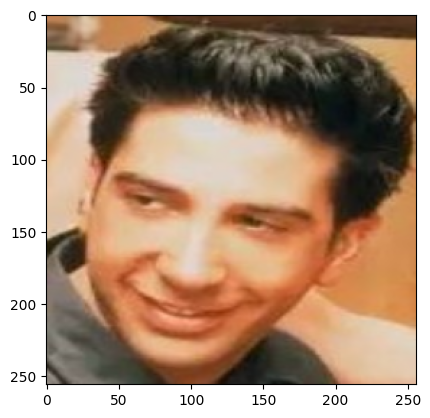

In [ ]:
plt.imshow(image)

In [ ]:
# prompt: load the pickle file /content/CAR CRASH CAUGHT ON GOPRO.pkl into haha

with open('/content/v1.pkl', 'rb') as f:
  result = pickle.load(f)


In [ ]:
print(result.keys())

dict_keys(['frame_22.0_sec', 'frame_24.0_sec', 'frame_32.0_sec', 'frame_23.0_sec', 'frame_27.0_sec', 'frame_40.0_sec', 'frame_13.0_sec', 'frame_25.0_sec', 'frame_34.0_sec', 'frame_53.0_sec'])


[809, 147, 151, 204]
[276, 142, 168, 229]


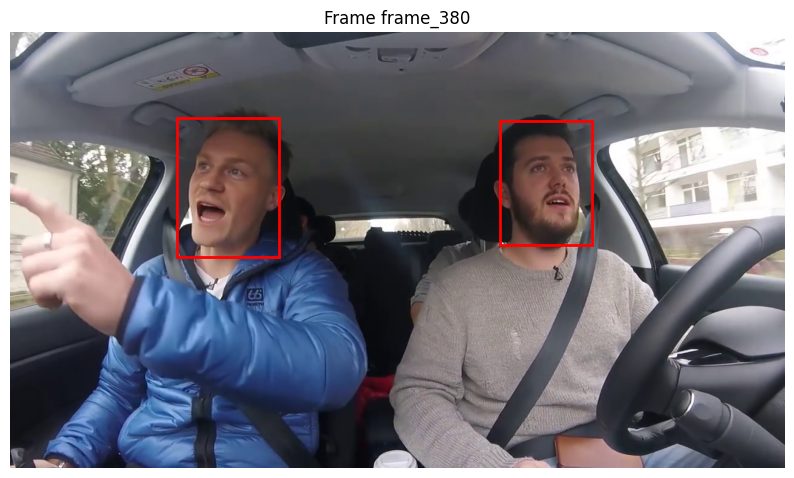

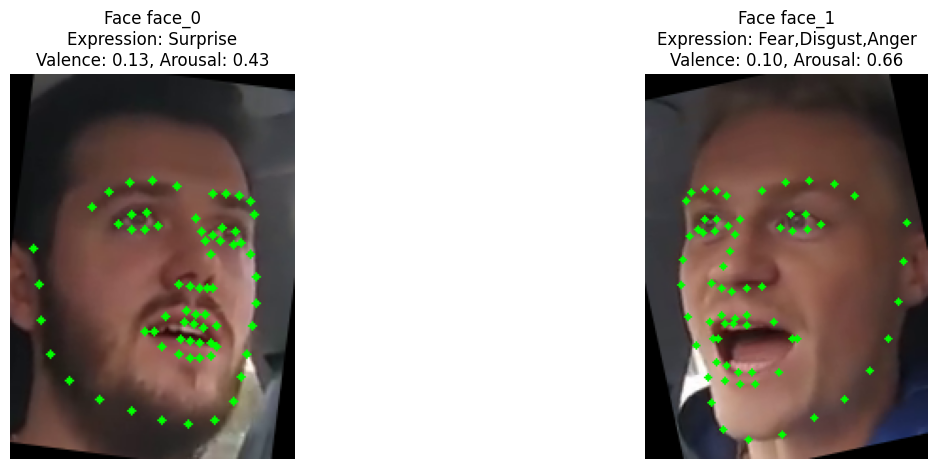

[815, 163, 176, 246]
[303, 218, 207, 251]


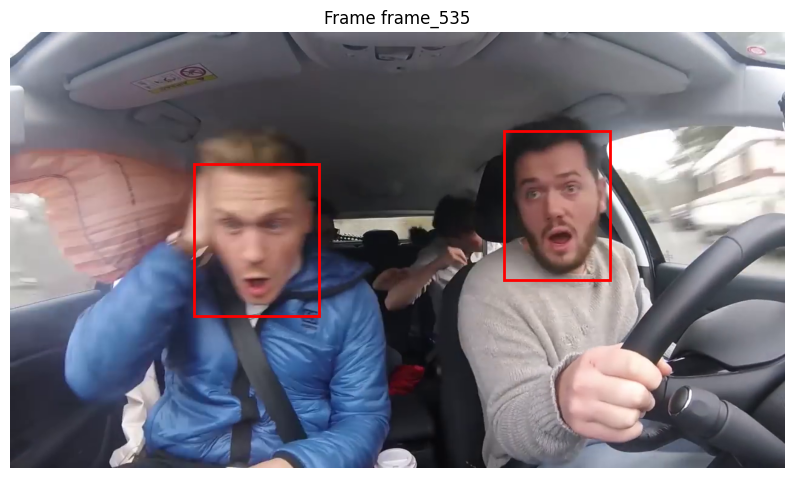

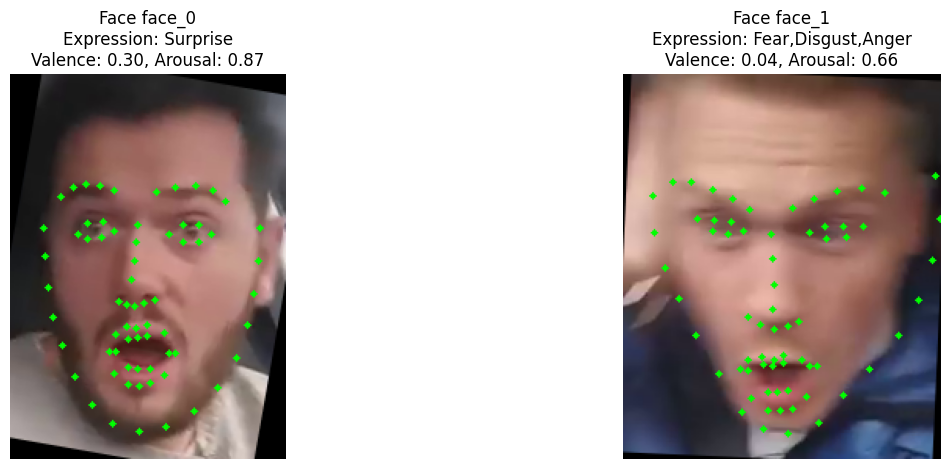

[267, 239, 191, 239]
[793, 155, 181, 255]
[478, 296, 103, 117]


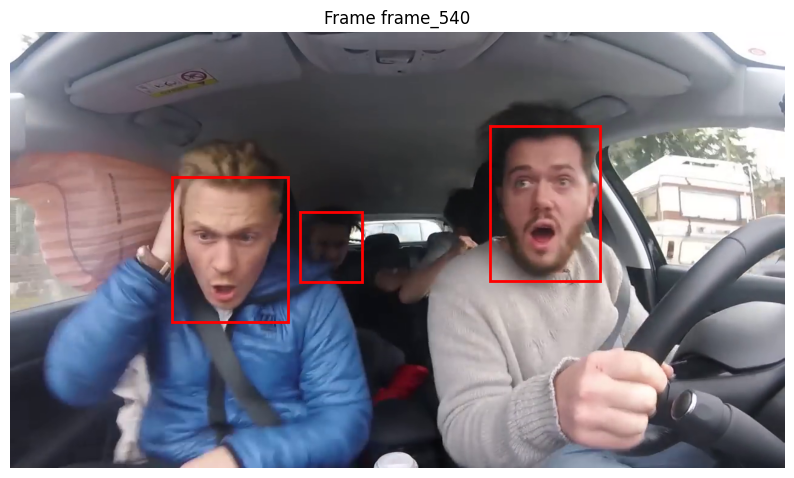

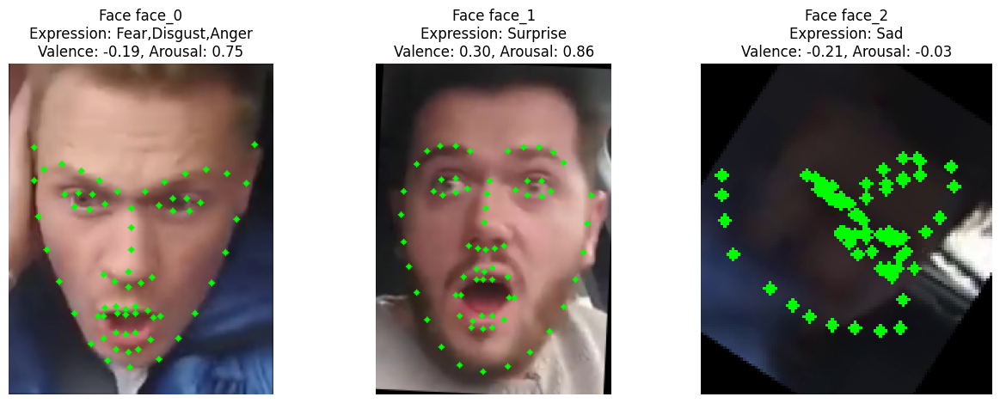

[813, 163, 168, 218]
[282, 180, 182, 231]


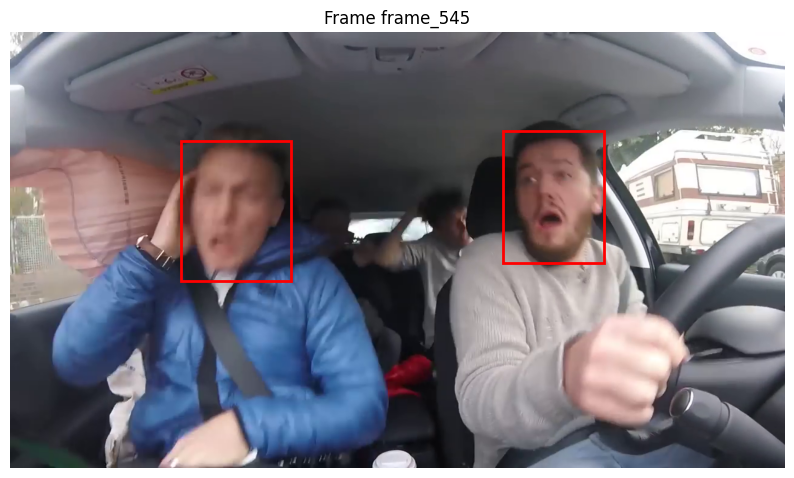

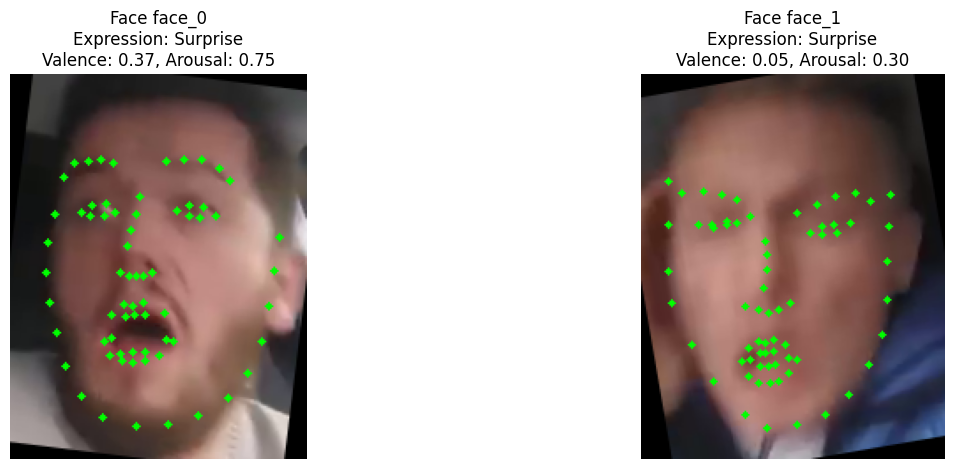

[846, 161, 166, 235]
[325, 235, 196, 240]


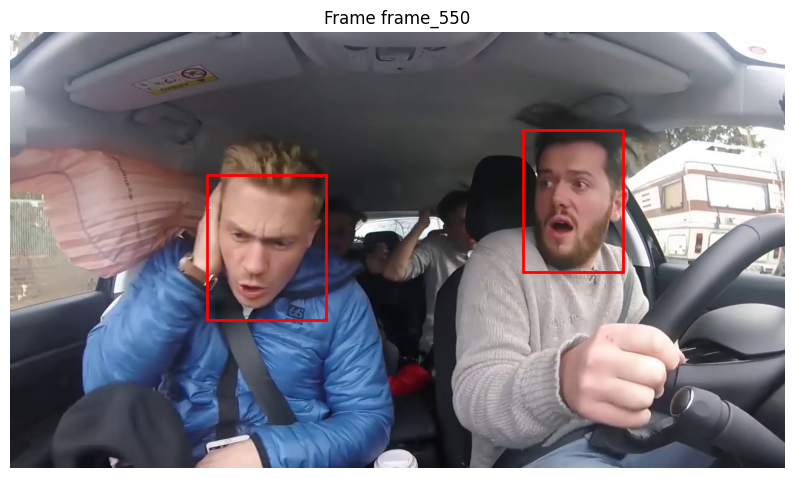

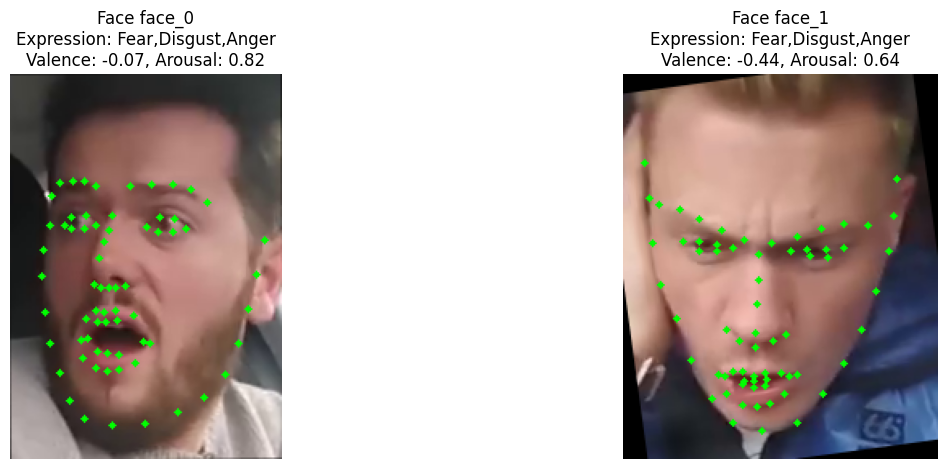

[811, 175, 171, 235]
[472, 275, 100, 115]
[294, 222, 191, 232]
[695, 274, 93, 111]


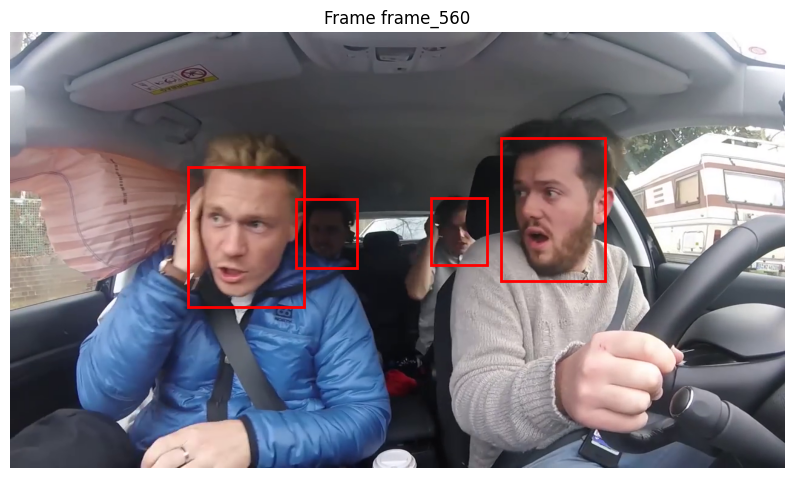

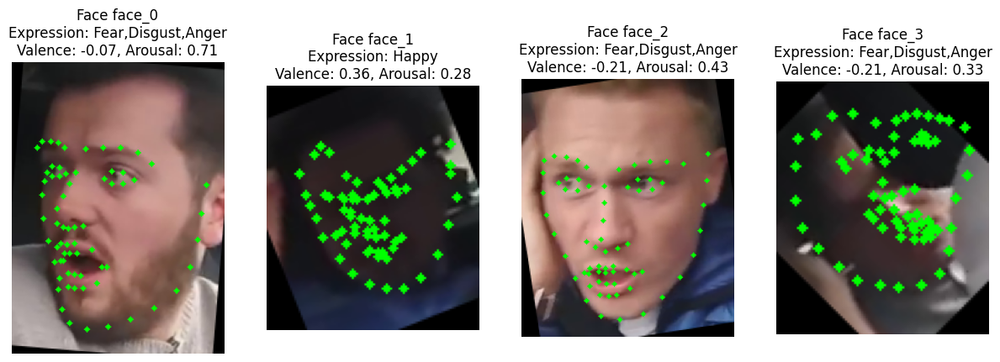

[824, 159, 167, 222]
[305, 225, 193, 243]


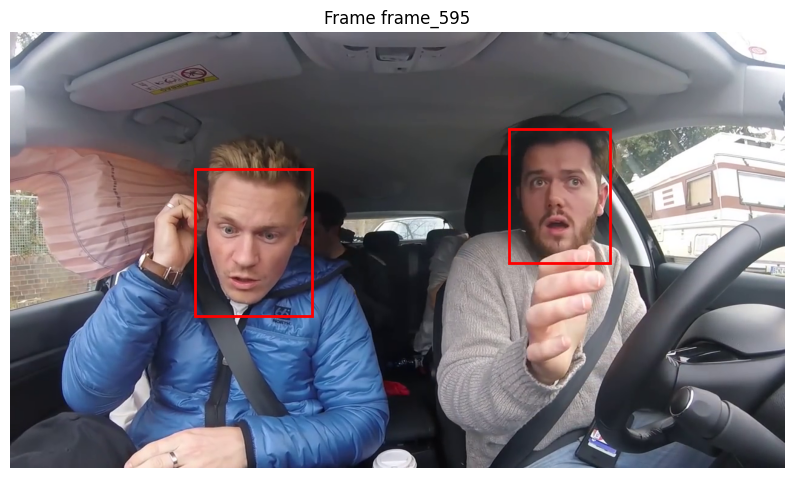

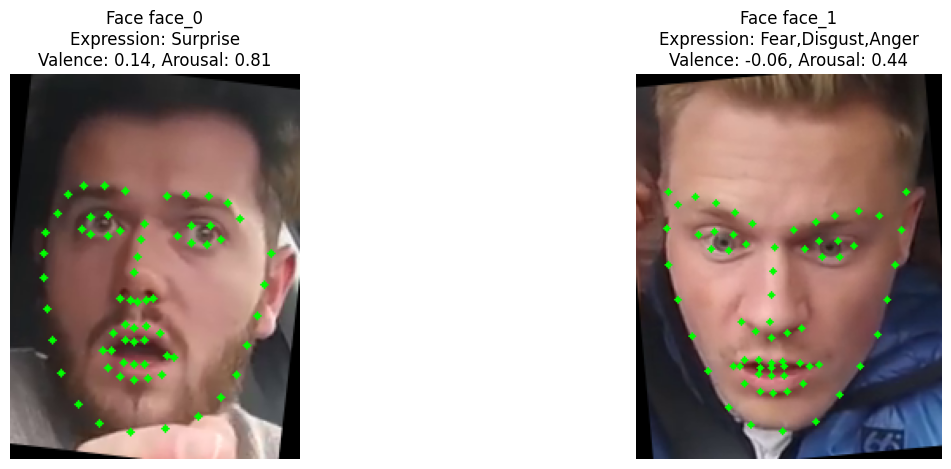

[822, 160, 166, 221]
[312, 223, 195, 244]


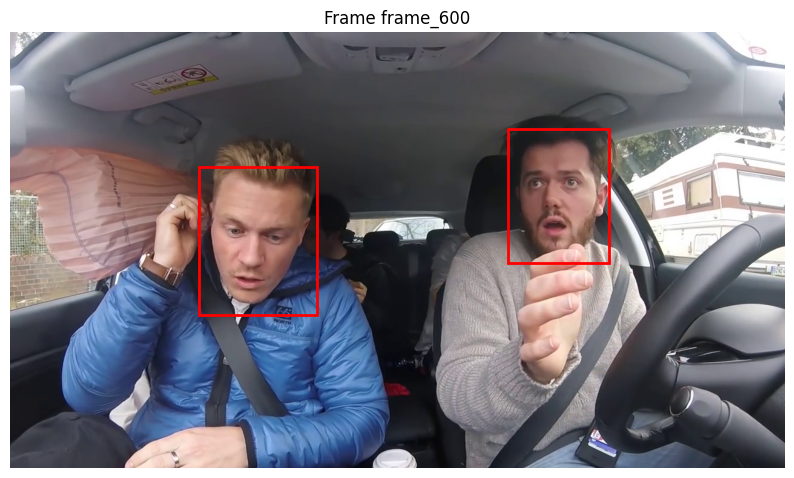

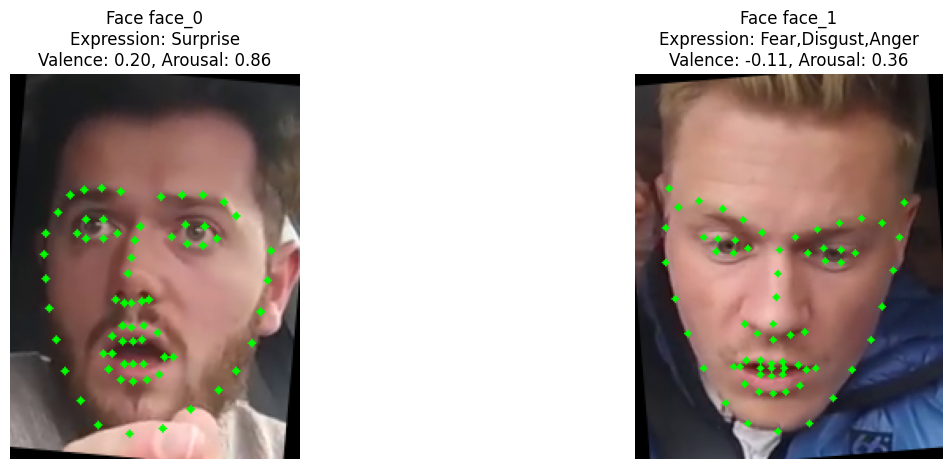

[817, 159, 166, 221]
[313, 222, 196, 243]


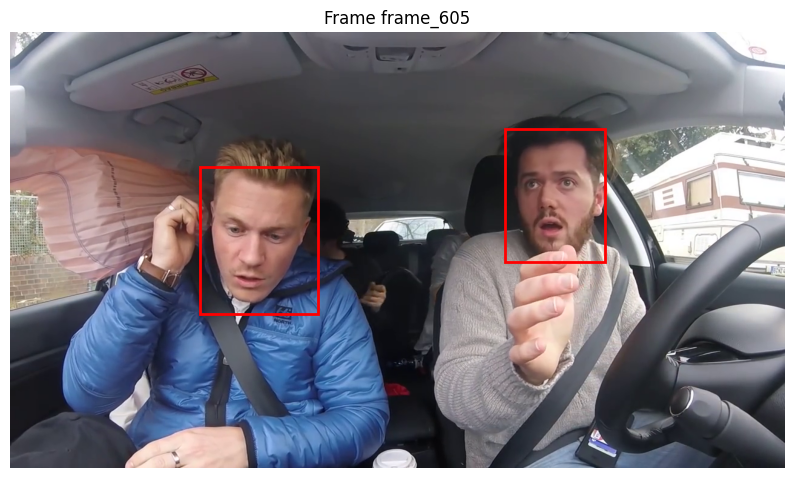

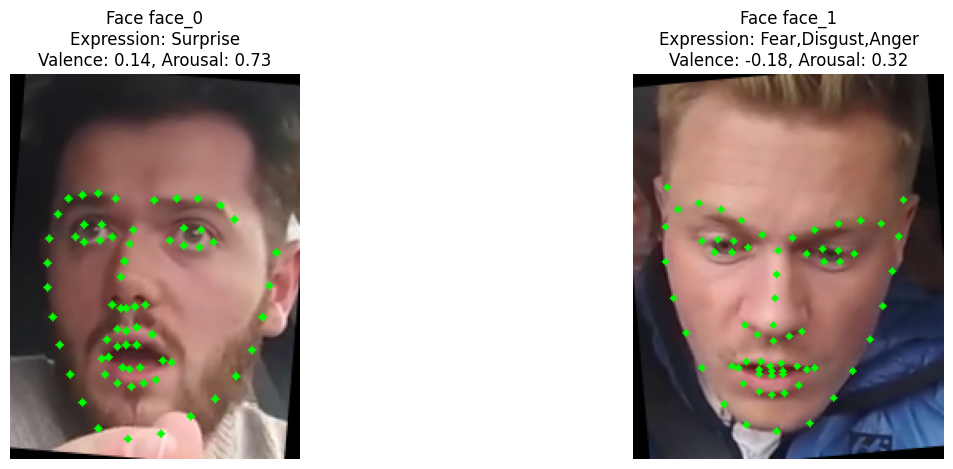

[806, 167, 165, 219]
[308, 215, 191, 247]


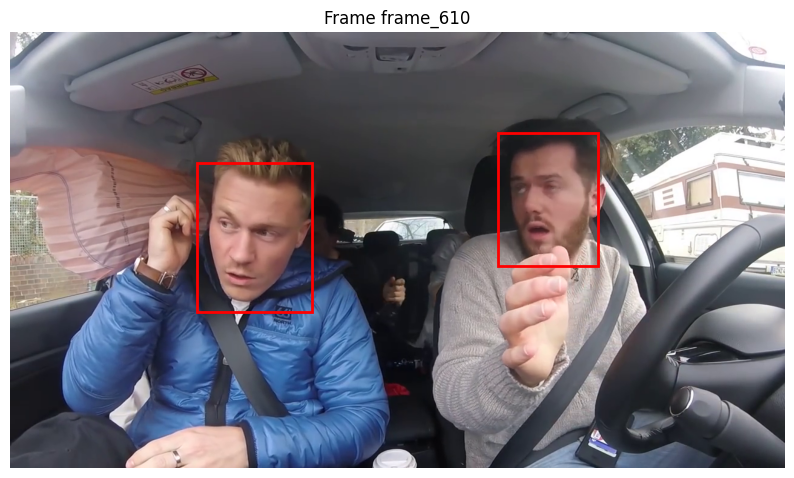

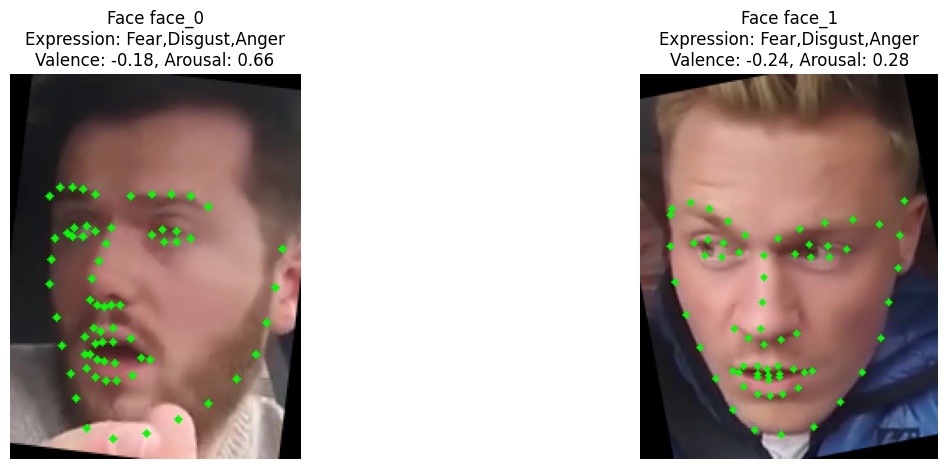

[826, 203, 141, 179]
[327, 101, 235, 332]
[580, 249, 103, 117]


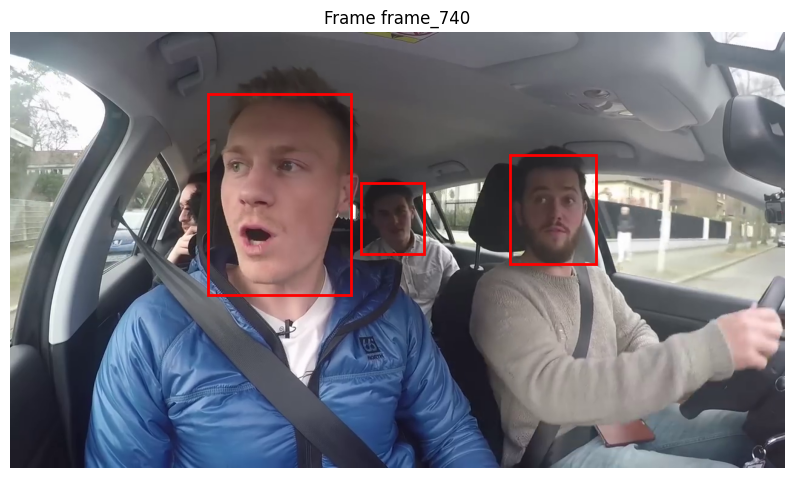

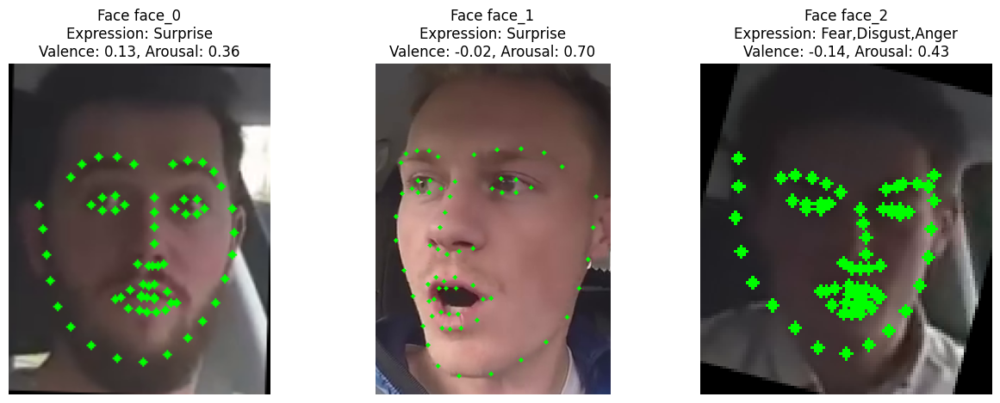

[878, 248, 153, 204]
[521, 295, 243, 319]


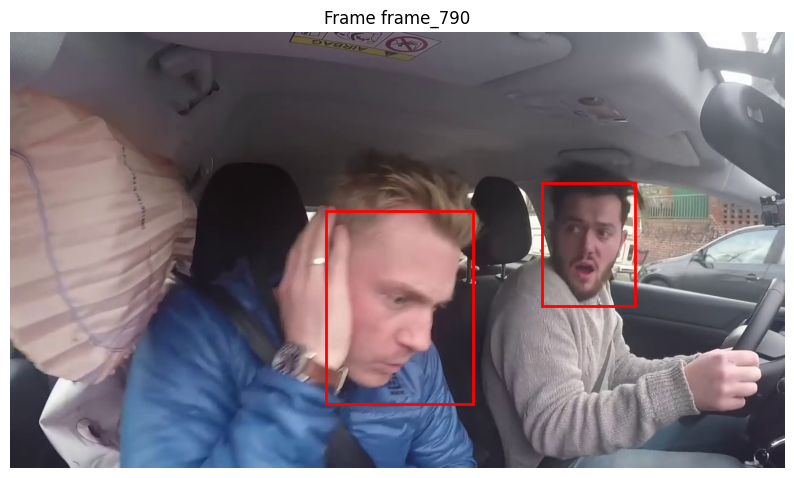

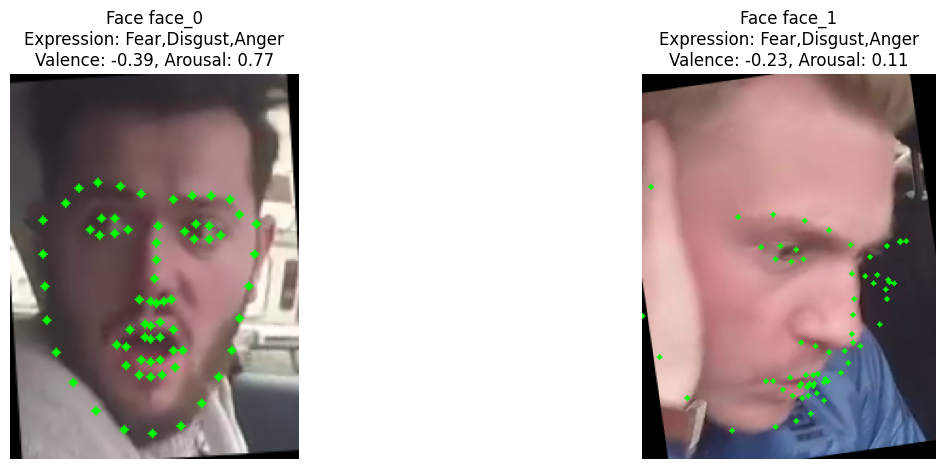

[880, 255, 151, 204]
[485, 257, 255, 335]


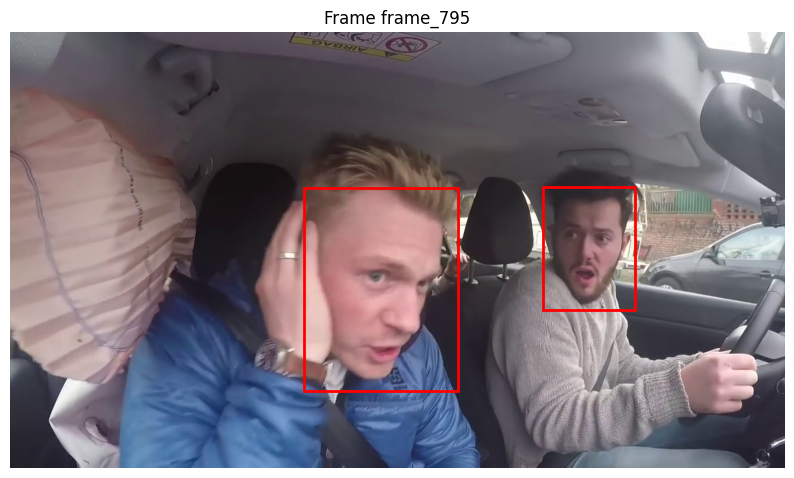

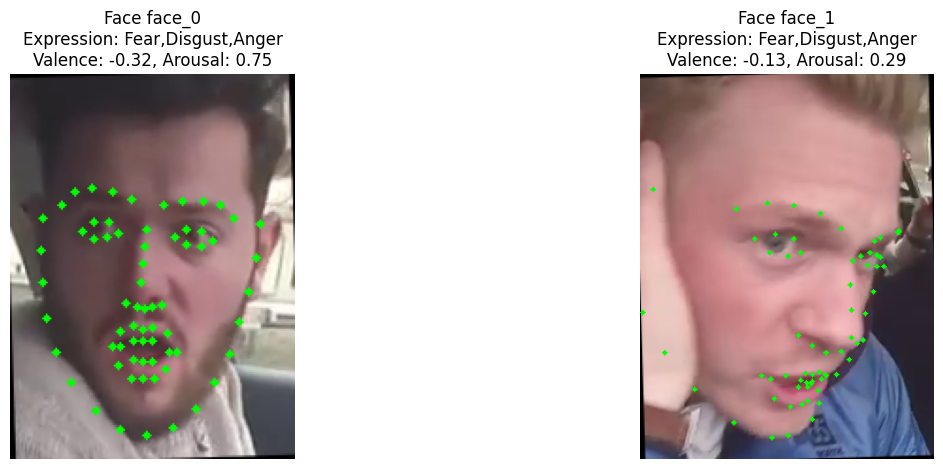

[892, 251, 147, 199]
[523, 257, 245, 324]


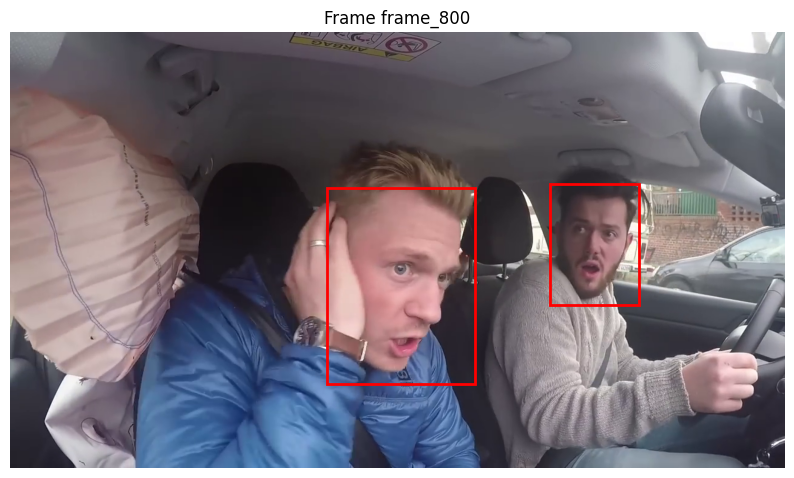

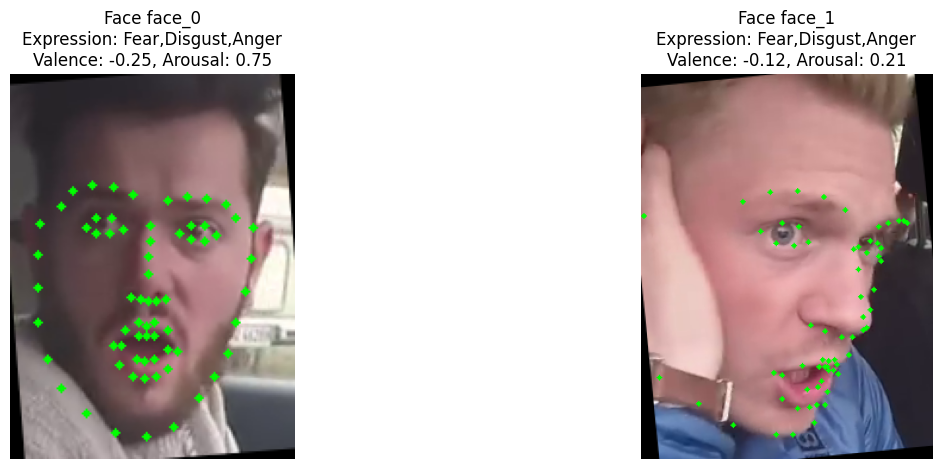

[871, 246, 146, 195]
[512, 243, 245, 338]


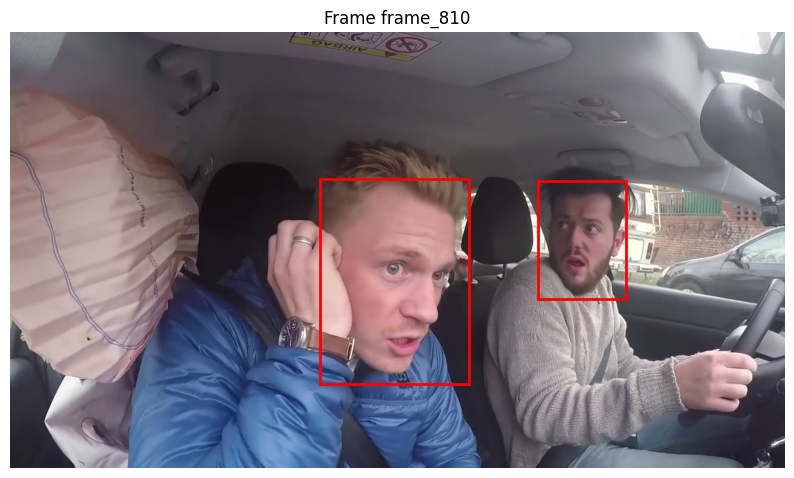

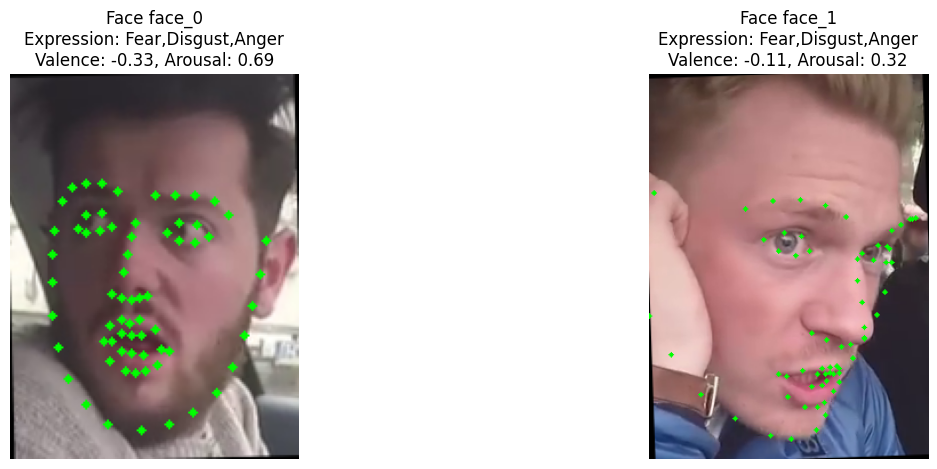

[143, 250, 159, 187]
[539, 200, 295, 354]


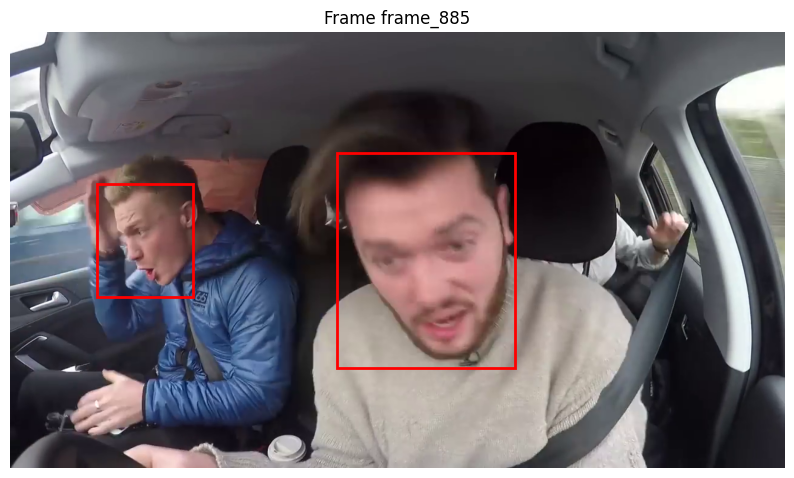

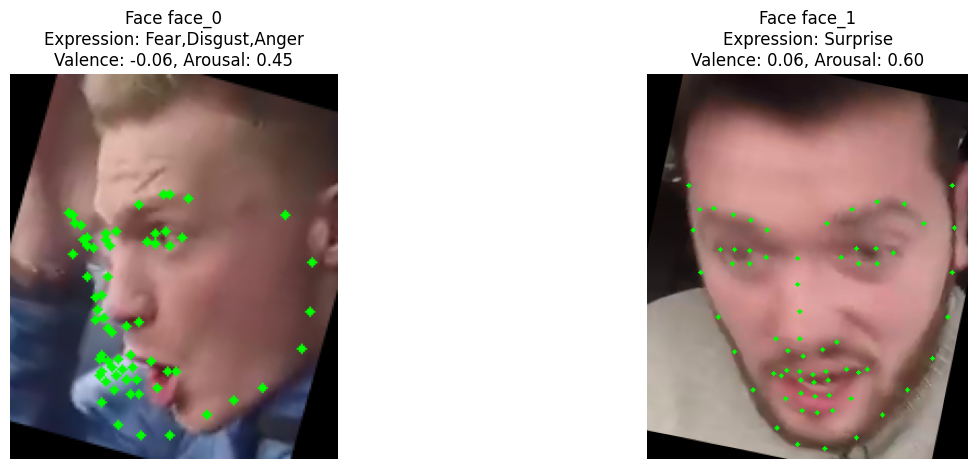

[210, 275, 155, 165]
[527, 169, 204, 343]


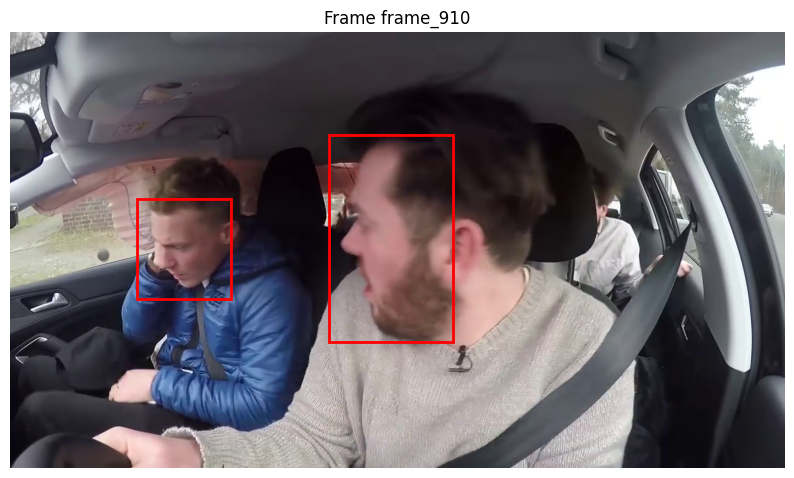

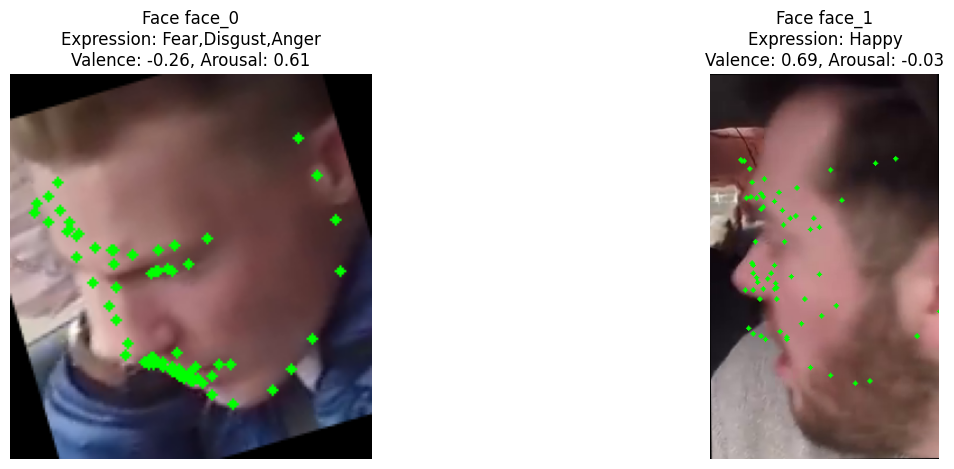

[231, 252, 149, 177]
[949, 230, 123, 158]
[612, 203, 133, 226]


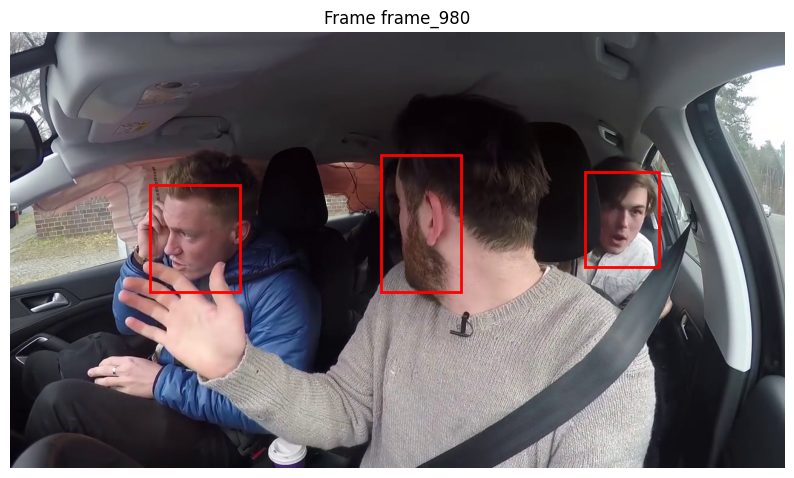

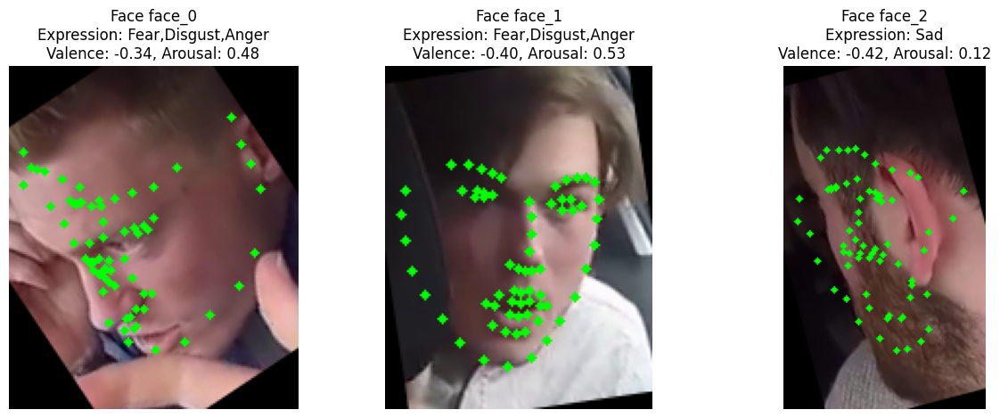

[949, 234, 129, 159]
[230, 251, 150, 172]


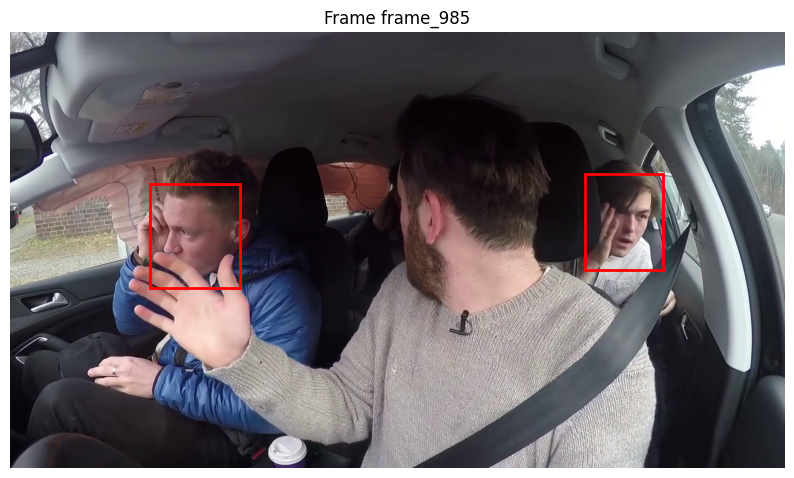

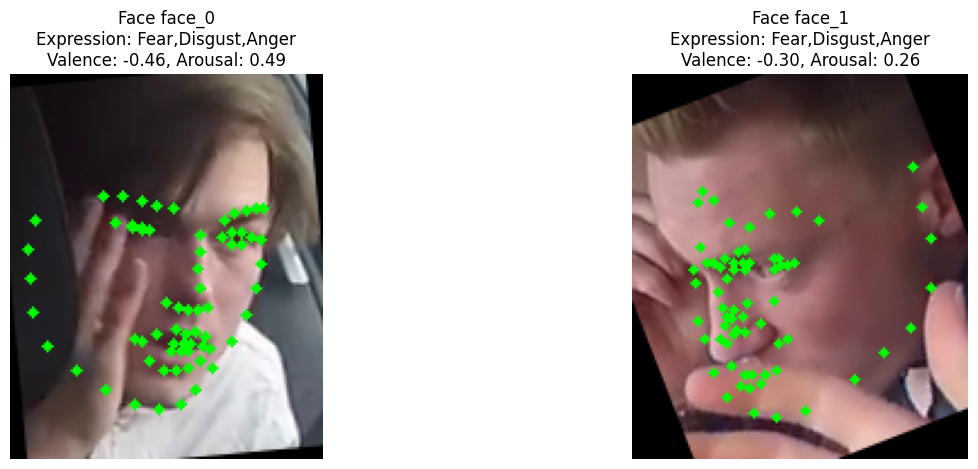

[231, 248, 151, 170]
[959, 233, 125, 157]


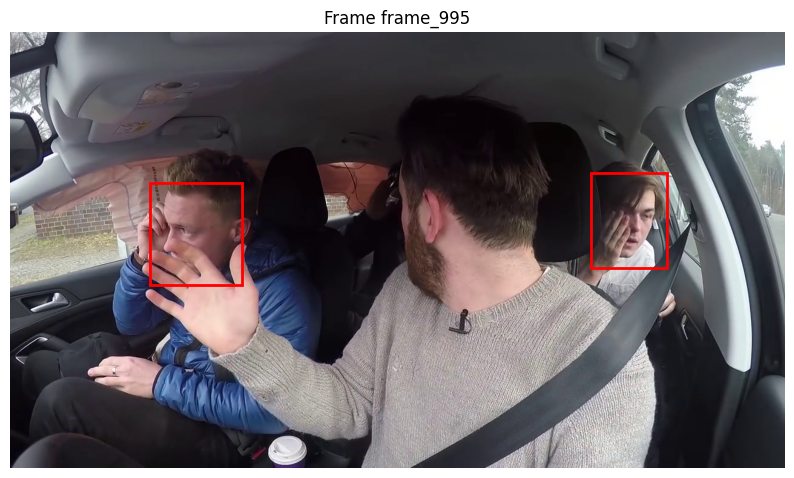

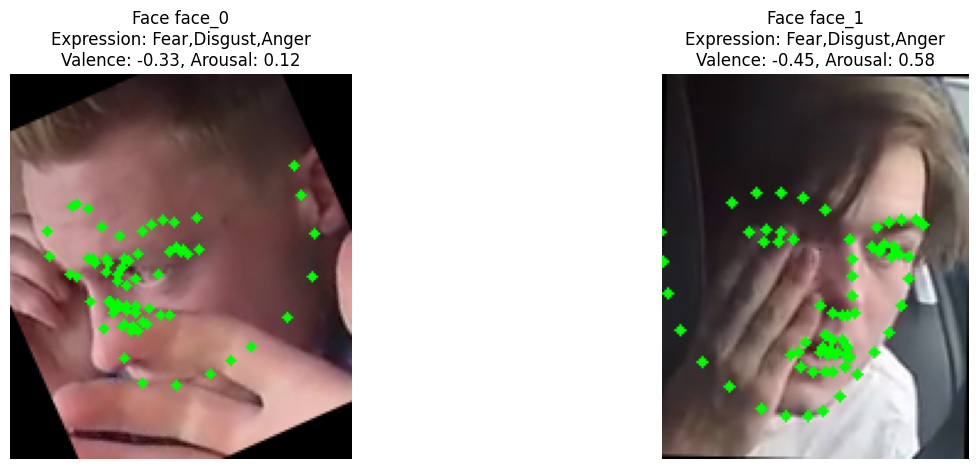

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
# Convert frame keys to numerical values for sorting
sorted_frames = sorted(result.keys(), key=lambda x: float(x.split('_')[1]))

# Visualize sorted frames
for frame_key in sorted_frames:
    frame_data = result[frame_key]

    # Plot the frame image
    frame_image = frame_data['frame_image']
    plt.figure(figsize=(10, 6))
    plt.imshow(cv2.cvtColor(frame_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Frame {frame_key}")
    plt.axis('off')  # Remove axis bars
    for idx, (face_id, face_data) in enumerate(frame_data.items()):
      if face_id == 'frame_image':
            continue
      x0, y0, w, h = face_data['bounding_box']
      rect = patches.Rectangle((x0, y0), w, h, linewidth=2, edgecolor='r', facecolor='none')
      plt.gca().add_patch(rect)
    plt.show()

    # Plot faces in a subplot
    num_faces = len(frame_data) - 1  # Excluding the 'frame_image' key
    fig, axes = plt.subplots(1, num_faces, figsize=(15, 5))

    if num_faces == 1:
        axes = [axes]  # Convert single axes to a list for iteration

    for idx, (face_id, face_data) in enumerate(frame_data.items()):
        if face_id == 'frame_image':
            continue

        # Get face information
        expression = face_data['expression']
        valence = face_data['valence']
        arousal = face_data['arousal']
        face_image = face_data['image']
        landmarks = face_data['landmarks']

        # Draw landmarks on the face image
        for landmark in landmarks:
            cv2.circle(face_image, (int(landmark[0]), int(landmark[1])), 2, (0, 255, 0), -1)  # Green circle

        # Plot face image with landmarks
        axes[idx].imshow(cv2.cvtColor(face_image, cv2.COLOR_BGR2RGB))
        axes[idx].set_title(f"Face {face_id}\nExpression: {expression}\nValence: {valence:.2f}, Arousal: {arousal:.2f}")
        axes[idx].axis('off')  # Remove axis bars

    plt.show()


In [ ]:
# prompt: rec delete output folder

!rm -rf output


In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

# Output folder path
output_folder = "output"
os.makedirs(output_folder, exist_ok=True)

# Convert frame keys to numerical values for sorting
sorted_frames = sorted(result.keys(), key=lambda x: float(x.split('_')[1]))

# Save and annotate sorted frames
for frame_key in sorted_frames:
    frame_data = result[frame_key]

    # Create a folder for the frame
    frame_folder = os.path.join(output_folder, f"frame_{frame_key}")
    os.makedirs(frame_folder, exist_ok=True)

    # Save and annotate the frame image
    frame_image_path = os.path.join(frame_folder, f"frame_{frame_key}.png")
    frame_image = cv2.cvtColor(frame_data['frame_image'], cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(10, 6))
    plt.imshow(frame_image)
    plt.title(f"Frame {frame_key}")
    plt.axis('off')  # Remove axis bars
    plt.savefig(frame_image_path)
    plt.close()

    # Save and annotate faces in a subplot
    num_faces = len(frame_data) - 1  # Excluding the 'frame_image' key

    for idx, (face_id, face_data) in enumerate(frame_data.items()):
        if face_id == 'frame_image':
            continue

        # Get face information
        expression = face_data['expression']
        valence = face_data['valence']
        arousal = face_data['arousal']
        face_image = face_data['image']
        landmarks = face_data['landmarks']

        # Draw landmarks on the face image
        for landmark in landmarks:
            cv2.circle(face_image, (int(landmark[0]), int(landmark[1])), 2, (0, 255, 0), -1)  # Green circle

        # Annotate face image with expressions, valence, and arousal
        plt.figure(figsize=(8, 5))
        plt.imshow(cv2.cvtColor(face_image, cv2.COLOR_BGR2RGB))
        plt.title(f"Face {face_id}\nExpression: {expression}\nValence: {valence:.2f}, Arousal: {arousal:.2f}")
        plt.axis('off')  # Remove axis bars

        # Save the annotated face image
        face_image_path = os.path.join(frame_folder, f"face_{face_id}.png")
        plt.savefig(face_image_path)
        plt.close()


KeyError: 'frame_image'

Face ID: face_0
Landmarks: [(20.764796787274573, 91.86898418258949), (19.582109290565906, 103.87619282183644), (20.66934434123944, 117.24112775161859), (22.684414185283625, 134.46673192275333), (26.71308583550659, 152.25129780733818), (31.717679739713006, 170.18513504114674), (40.042852245474215, 187.13569016086063), (50.843964021881945, 201.06712913179), (68.95303423439891, 206.2625298519331), (87.22761874449523, 203.0098608914787), (103.67539701270073, 192.2370754755558), (119.01556532106842, 181.73362506649693), (129.8463251066703, 170.44583623904276), (138.1187557978234, 154.5414690884262), (143.2799653982977, 136.78120626529426), (147.3980425280556, 118.92336089274414), (149.7202165679232, 101.22030350093272), (27.946147010469303, 79.08742059248178), (34.005428777620764, 69.624789219613), (42.444688459228644, 66.2151058443394), (52.68949413502033, 65.33631582910806), (63.22823043505212, 67.8537638663423), (86.89318043824082, 70.46821889887403), (98.41138156026736, 69.1796267139455

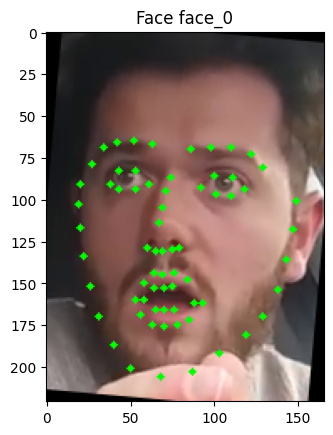

Face ID: face_1
Landmarks: [(21.818169395562396, 72.29415073971983), (19.86586872825107, 97.44573066685811), (19.964740186190763, 119.84235257108806), (25.658534561941668, 142.4987174008655), (33.27355370004397, 164.50794455852952), (43.91277898262457, 186.17092528970363), (57.932762763033864, 208.7214394034237), (71.39226974995417, 221.66821017001757), (90.35376914445588, 226.55961678797792), (110.76281273078916, 221.33254564232834), (125.67997745298223, 205.1973673915538), (137.9866309943866, 187.97413312798912), (149.13333396924332, 168.0325825536611), (156.78983711570774, 147.02551977288516), (163.84052043332917, 124.64420883804526), (167.35570565354175, 103.23056354805993), (170.19714610733328, 81.08527385320734), (27.612037577750158, 84.98225355590732), (40.66041480984887, 80.9740544232578), (55.58055654126551, 85.46996323582556), (68.50438470394404, 92.47206176635544), (80.66904737493812, 100.5637973935111), (101.22806304955901, 103.51364721129886), (115.0668952944227, 98.742472

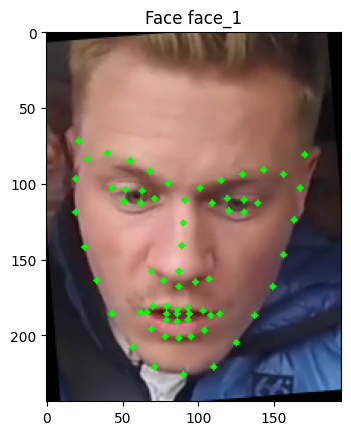

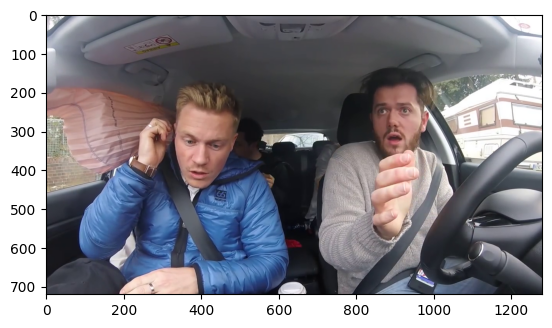

In [ ]:

# Print the result and draw landmarks on the images
for face_id, face_data in result['frame_24.0_sec'].items():
    if face_id=='frame_image':
      plt.imshow(cv2.cvtColor(face_data, cv2.COLOR_BGR2RGB))
      plt.show()
      continue
    # Get the image and landmarks
    expression=face_data['expression']
    valence=face_data['valence']
    arousal=face_data['arousal']
    face_image = face_data['image']
    landmarks = face_data['landmarks']
    # Draw landmarks on the image
    for landmark in landmarks:
        cv2.circle(face_image, (int(landmark[0]), int(landmark[1])), 2, (0, 255, 0), -1)  # Green circle

    # Display or save the image with landmarks
    plt.imshow(cv2.cvtColor(face_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Face {face_id} , expression {expression}")
    plt.show()


In [ ]:
result.keys()

dict_keys(['frame_22.0_sec', 'frame_24.0_sec', 'frame_32.0_sec', 'frame_23.0_sec', 'frame_27.0_sec', 'frame_40.0_sec', 'frame_13.0_sec', 'frame_25.0_sec', 'frame_34.0_sec', 'frame_53.0_sec'])

In [ ]:
!pip install nbformat


In [ ]:
import nbformat

def extract_packages(notebook_path):
    with open(notebook_path, 'r', encoding='utf-8') as notebook_file:
        notebook_content = nbformat.read(notebook_file, as_version=4)

    cells = notebook_content['cells']
    packages = set()

    for cell in cells:
        if cell['cell_type'] == 'code':
            source_lines = cell['source'].split('\n')
            for line in source_lines:
                if line.startswith('!pip install'):
                    packages.add(line.replace('!pip install', '').strip())

    return packages

# Provide the path to your notebook (.ipynb) file
notebook_path = '/content/drive/MyDrive/Colab Notebooks/emofan.ipynb'
used_packages = extract_packages(notebook_path)
print("Packages used in the notebook:", used_packages)


Packages used in the notebook: {'-e .', '-U insightface', 'nbformat', 'onnxruntime'}


In [ ]:
# Install virtualenv
!pip install virtualenv

# Create a virtual environment named 'myenv'
!virtualenv myenv

# Activate the virtual environment
!source myenv/bin/activate

# Note: In Colab, the 'source' command might not work as expected, so you can use the following alternative:
# Install the IPython kernel
!pip install ipykernel

# Add the virtual environment as a kernel
!python -m ipykernel install --user --name=myenv

# Now you can use the virtual environment in your Colab notebook.
# If you want to install packages within this virtual environment, use '!pip install' as usual.


created virtual environment CPython3.10.12.final.0-64 in 240ms
  creator CPython3Posix(dest=/content/SPIGA/myenv, clear=False, no_vcs_ignore=False, global=False)
  seeder FromAppData(download=False, pip=bundle, setuptools=bundle, wheel=bundle, via=copy, app_data_dir=/root/.local/share/virtualenv)
    added seed packages: pip==23.3.1, setuptools==69.0.2, wheel==0.42.0
  activators BashActivator,CShellActivator,FishActivator,NushellActivator,PowerShellActivator,PythonActivator
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 13.4 MB/s eta 0:00:00
Installed kernelspec myenv in /root/.local/share/jupyter/kernels/myenv


In [ ]:
import sys
from pathlib import Path

# Path to your virtual environment
venv_path = Path("/content/SPIGA/myenv")

# Check if the virtual environment is active
if hasattr(sys, 'real_prefix') or (hasattr(sys, 'base_prefix') and sys.base_prefix != sys.prefix):
    print("Virtual environment is active.")
else:
    # Change the working directory to the virtual environment
    %cd {venv_path}

    # Activate the virtual environment
    !source bin/activate

    print("Virtual environment activated.")


/content/SPIGA/myenv
Virtual environment activated.


In [ ]:
import numpy

In [ ]:
# Change the working directory to the virtual environment
%cd /content/SPIGA/myenv

# Activate the virtual environment
!source bin/activate

# Check if the virtual environment is active
import sys
if hasattr(sys, 'real_prefix') or (hasattr(sys, 'base_prefix') and sys.base_prefix != sys.prefix):
    print("Virtual environment is active.")
else:
    print("Virtual environment is not active.")


/content/SPIGA/myenv
Virtual environment is not active.


In [ ]:
!zip -r output.zip /content/output

  adding: content/output/ (stored 0%)
  adding: content/output/frame_frame_16.0_sec/ (stored 0%)
  adding: content/output/frame_frame_16.0_sec/frame_frame_16.0_sec.png (deflated 1%)
  adding: content/output/frame_frame_16.0_sec/face_face_2.png (deflated 3%)
  adding: content/output/frame_frame_16.0_sec/face_face_0.png (deflated 9%)
  adding: content/output/frame_frame_16.0_sec/face_face_1.png (deflated 2%)
  adding: content/output/frame_frame_16.0_sec/face_face_3.png (deflated 9%)
  adding: content/output/frame_frame_38.0_sec/ (stored 0%)
  adding: content/output/frame_frame_38.0_sec/face_face_2.png (deflated 3%)
  adding: content/output/frame_frame_38.0_sec/face_face_0.png (deflated 2%)
  adding: content/output/frame_frame_38.0_sec/face_face_1.png (deflated 2%)
  adding: content/output/frame_frame_38.0_sec/frame_frame_38.0_sec.png (deflated 1%)
  adding: content/output/frame_frame_13.0_sec/ (stored 0%)
  adding: content/output/frame_frame_13.0_sec/face_face_0.png (deflated 2%)
  addin

In [ ]:
import cv2

def play_video(video_path):
    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Check if the video file is opened successfully
    if not cap.isOpened():
        print("Error: Could not open video.")
        return

    # Get the video properties
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Create a window to display the video
    cv2.namedWindow('Video Player', cv2.WINDOW_NORMAL)
    cv2.resizeWindow('Video Player', width, height)

    while True:
        # Read a frame from the video
        ret, frame = cap.read()

        # If the frame is not read successfully, break the loop
        if not ret:
            break

        # Display the frame
        cv2.imshow('Video Player', frame)

        # Check for the 'q' key to exit the loop
        if cv2.waitKey(30) & 0xFF == ord('q'):
            break

    # Release the video capture object and close the window
    cap.release()
    cv2.destroyAllWindows()

# Replace '/content/v1.mp4' with the path to your video file
play_video('/content/v1.mp4')


In [ ]:
from IPython.display import HTML
from base64 import b64encode

video_path = '/content/v1.mp4'

# Function to display video
def play_video(video_path):
    video_file = open(video_path, "rb").read()
    video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"
    return HTML(f'<video width="640" height="360" controls><source src="{video_url}" type="video/mp4"></video>')

# Call the function to play the video
play_video(video_path)


In [ ]:
import cv2
from google.colab.patches import cv2_imshow

video_path = '/content/v1.mp4'

# Open the video file
cap = cv2.VideoCapture(video_path)

# Check if the video file is opened successfully
if not cap.isOpened():
    print("Error: Could not open video.")
else:
    while True:
        # Read a frame from the video
        ret, frame = cap.read()

        # If the frame is not read successfully, break the loop
        if not ret:
            break

        # Display the frame
        cv2_imshow(frame)

    # Release the video capture object
    cap.release()


In [ ]:

with open('/content/v1.pkl', 'rb') as f:
  v1pkl = pickle.load(f)

In [ ]:
print(f"this is the frame ids {v1pkl.keys()}") # this is the frame ids
print(f"this is the frame faces + the frame whole image {list(v1pkl.values())[0].keys()}") #this is the frame faces + the frame whole image
print(f"this is the whole image {type(list(v1pkl.values())[0]['frame_image'])}") # this is the whole image
print(f"this is the attributes of the face {list(v1pkl.values())[0]['face_0'].keys()}") # this is the attributes of the face
for k,v in list(v1pkl.values())[0]['face_0'].items():
    if k=='image':
        print(f"this is {k} : cropped face of shape {v.shape}")
        continue
    print(f"this is {k} : {v}")

this is the frame ids dict_keys(['frame_550', 'frame_535', 'frame_910', 'frame_595', 'frame_540', 'frame_600', 'frame_545', 'frame_795', 'frame_980', 'frame_605', 'frame_380', 'frame_790', 'frame_810', 'frame_995', 'frame_985', 'frame_610', 'frame_885', 'frame_800', 'frame_740', 'frame_560'])
this is the frame faces + the frame whole image dict_keys(['face_0', 'face_1', 'frame_image'])
this is the whole image <class 'numpy.ndarray'>
this is the attributes of the face dict_keys(['image', 'landmarks', 'headpose', 'bounding_box', 'expression', 'valence', 'arousal'])
this is image : cropped face of shape (235, 166, 3)
this is landmarks : [(24.58656465915659, 92.55114982798636), (20.730550718509953, 107.33052771272851), (19.717278003577366, 123.81138803141579), (21.067154215462683, 145.533395946581), (24.13634380044673, 164.59232101010264), (30.09727962271675, 182.70277974787825), (36.20124085220271, 199.1153468778188), (45.78551410828656, 210.1629625651575), (62.70943051415141, 214.4635214

In [ ]:
import cv2
import pickle

# Load the pickle file
with open('/content/v1.pkl', 'rb') as f:
    v1pkl = pickle.load(f)

# Video file
video_path = '/content/v1.mp4'  # Update with the actual path to your video file

# Open the video file
cap = cv2.VideoCapture(video_path)

# Get video properties
fps = cap.get(cv2.CAP_PROP_FPS)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Create VideoWriter object to save the output video
output_video_path = 'output_video.avi'
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))

# Loop through each frame in the video
frame_id_list = list(v1pkl.keys())
current_annotation_index = 0

for frame_index in range(int(cap.get(cv2.CAP_PROP_FRAME_COUNT))):
    # Read the frame from the original video
    ret, frame = cap.read()
    if not ret:
        break

    # Check if the current frame has annotations
    frame_id = f'frame_{frame_index}'
    if frame_id in frame_id_list:
        # Get annotations for the current frame
        frame_annotations = v1pkl[frame_id]['face_0']

        # Extract bounding box and emotion information
        bounding_box = frame_annotations['bounding_box']
        valence = frame_annotations['valence']
        arousal = frame_annotations['arousal']
        expression = frame_annotations['expression']

        # Draw bounding box on the face
        x, y, w, h = bounding_box
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

        # Label with valence, arousal, and emotion
        label = f'Valence: {valence:.2f}, Arousal: {arousal:.2f}, Emotion: {expression}'
        cv2.putText(frame, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Write the frame to the output video
    out.write(frame)

# Release video capture and writer
cap.release()
out.release()

# Close all OpenCV windows
cv2.destroyAllWindows()


In [ ]:
import cv2
import pickle

def generate_annotated_video(video_path, output_path, pickle_path, annotated_frames=None):
    # Load the pickle file
    with open(pickle_path, 'rb') as f:
        annotations = pickle.load(f)

    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Get video properties
    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Create VideoWriter object to save the output video
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    # Get the list of frames to be annotated
    if annotated_frames is None:
        annotated_frames = list(annotations.keys())

    current_annotation_index = 0

    # Loop through each frame in the video
    for frame_index in range(int(cap.get(cv2.CAP_PROP_FRAME_COUNT))):
        # Read the frame from the original video
        ret, frame = cap.read()
        if not ret:
            break

        # Check if the current frame has annotations
        frame_id = f'frame_{frame_index}'
        if frame_id in annotated_frames:
            # Get annotations for the current frame
            frame_annotations = annotations[frame_id]['face_0']

            # Extract bounding box and emotion information
            bounding_box = frame_annotations['bounding_box']
            valence = frame_annotations['valence']
            arousal = frame_annotations['arousal']
            expression = frame_annotations['expression']

            # Draw bounding box on the face
            x, y, w, h = bounding_box
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

            # Label with valence, arousal, and emotion
            label = f'Valence: {valence:.2f}, Arousal: {arousal:.2f}, Emotion: {expression}'
            cv2.putText(frame, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Write the frame to the output video
        out.write(frame)

    # Release video capture and writer
    cap.release()
    out.release()

    # Close all OpenCV windows
    cv2.destroyAllWindows()

# Example usage
generate_annotated_video('/content/v1.mp4', '/content/output_video.avi', '/content/v1.pkl')


In [ ]:
import cv2
import pickle
import numpy as np

def calculate_intensity(valence, arousal):
    return np.sqrt(valence**2 + arousal**2)

def generate_annotated_video(video_path, output_path, pickle_path, annotated_frames=None):
    # Load the pickle file
    with open(pickle_path, 'rb') as f:
        annotations = pickle.load(f)

    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Get video properties
    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Create VideoWriter object to save the output video
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    # Get the list of frames to be annotated
    if annotated_frames is None:
        annotated_frames = list(annotations.keys())

    current_annotation_index = 0

    # Loop through each frame in the video
    for frame_index in range(int(cap.get(cv2.CAP_PROP_FRAME_COUNT))):
        # Read the frame from the original video
        ret, frame = cap.read()
        if not ret:
            break

        # Check if the current frame is annotated
        frame_id = f'frame_{frame_index}'
        if frame_id in annotated_frames:
            # Get annotations for the current frame
            frame_annotations = annotations[frame_id]

            # Calculate average intensity of emotions for all faces
            face_intensities = [calculate_intensity(face['valence'], face['arousal'])
                                for k,face in frame_annotations.items() if k!='frame_image']

            if face_intensities:
                avg_intensity = np.mean(face_intensities)

                # Draw average intensity on the top of the frame
                cv2.putText(frame, f'Avg Intensity: {avg_intensity:.2f}', (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

            # Loop through each face in the frame and annotate
            for face_key, face_data in frame_annotations.items():
                if 'face' in face_key:
                    # Extract bounding box and emotion information
                    bounding_box = face_data['bounding_box']
                    valence = face_data['valence']
                    arousal = face_data['arousal']
                    expression = face_data['expression']

                    # Calculate intensity of emotions
                    intensity = calculate_intensity(valence, arousal)

                    # Draw bounding box on the face with unique color
                    color = tuple(np.random.randint(0, 255, 3).tolist())
                    x, y, w, h = bounding_box
                    cv2.rectangle(frame, (x, y), (x + w, y + h), color, 2)

                    # Label with valence, arousal, and emotion (shortened)
                    label = f'V:{valence:.2f}, A:{arousal:.2f}, I:{intensity:.2f}, E:{expression}'
                    cv2.putText(frame, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

        # Write the frame to the output video
        out.write(frame)

    # Release video capture and writer
    cap.release()
    out.release()

    # Close all OpenCV windows
    cv2.destroyAllWindows()

# Example usage
generate_annotated_video('/content/v1.mp4', '/content/output_video2.avi', '/content/v1.pkl')


In [ ]:
import cv2
import pickle
import numpy as np

def calculate_intensity(valence, arousal):
    return np.sqrt(valence**2 + arousal**2)

def generate_annotated_video(video_path, output_path, pickle_path, annotated_frames=None, freeze_factor=10):
    # Load the pickle file
    with open(pickle_path, 'rb') as f:
        annotations = pickle.load(f)

    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Get video properties
    fps = cap.get(cv2.CAP_PROP_FPS)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

    # Create VideoWriter object to save the output video
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

    # Get the list of frames to be annotated
    if annotated_frames is None:
        annotated_frames = list(annotations.keys())

    current_annotation_index = 0

    # Loop through each frame in the video
    for frame_index in range(int(cap.get(cv2.CAP_PROP_FRAME_COUNT))):
        # Read the frame from the original video
        ret, frame = cap.read()
        if not ret:
            break

        # Check if the current frame is annotated
        frame_id = f'frame_{frame_index}'
        if frame_id in annotated_frames:
            # Get annotations for the current frame
            frame_annotations = annotations[frame_id]

            # Calculate average intensity of emotions for all faces
            face_intensities = [calculate_intensity(face['valence'], face['arousal'])
                                for k,face in frame_annotations.items() if k!='frame_image']

            if face_intensities:
                avg_intensity = np.mean(face_intensities)

                # Draw average intensity on the top of the frame
                cv2.putText(frame, f'Avg Intensity: {avg_intensity:.2f}', (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

            # Loop through each face in the frame and annotate
            for face_key, face_data in frame_annotations.items():
                if 'face' in face_key:
                    # Extract bounding box and emotion information
                    bounding_box = face_data['bounding_box']
                    valence = face_data['valence']
                    arousal = face_data['arousal']
                    expression = face_data['expression']

                    # Calculate intensity of emotions
                    intensity = calculate_intensity(valence, arousal)

                    # Draw bounding box on the face with unique color
                    color = tuple(np.random.randint(0, 255, 3).tolist())
                    x, y, w, h = bounding_box
                    cv2.rectangle(frame, (x, y), (x + w, y + h), color, 2)

                    # Label with valence, arousal, and emotion (shortened)
                    label = f'V:{valence:.2f}, A:{arousal:.2f}, I:{intensity:.2f}, E:{expression}'
                    cv2.putText(frame, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

            # Repeat the annotated frame multiple times (freeze effect)
            for _ in range(freeze_factor):
                out.write(frame)
        else:
            # Write the original frame to the output video
            out.write(frame)

    # Release video capture and writer
    cap.release()
    out.release()

    # Close all OpenCV windows
    cv2.destroyAllWindows()

# Example usage with freeze_factor set to 10
generate_annotated_video('/content/drive/MyDrive/v1.mp4', '/content/output_video3.avi', '/content/drive/MyDrive/v1.pkl',freeze_factor=1)


In [ ]:
# prompt: copy /content/output_video3.avi to /content/drive/MyDrive/output_video3.avi

!cp /content/output_video3.avi /content/drive/MyDrive/output_video3.avi


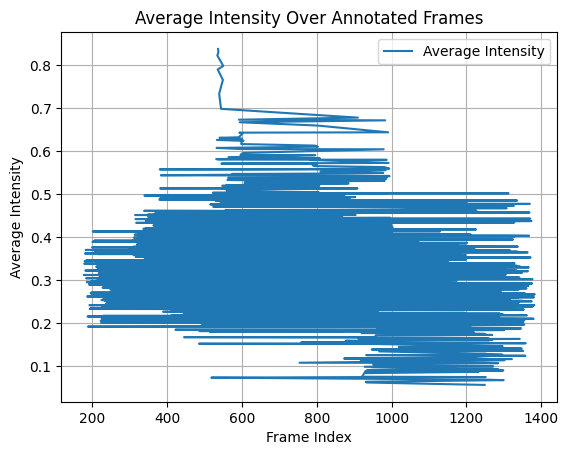

In [ ]:
import matplotlib.pyplot as plt
import pickle
import numpy as np

def calculate_intensity(valence, arousal):
    return np.sqrt(valence**2 + arousal**2)

def plot_average_intensity(pickle_path, output_plot_path='average_intensity_plot.png'):
    # Load the pickle file
    with open(pickle_path, 'rb') as f:
        annotations = pickle.load(f)

    # Initialize lists to store frame indices and average intensities
    frame_indices = []
    average_intensities = []

    # Loop through each annotated frame
    for frame_id, frame_data in annotations.items():
        # Calculate average intensity of emotions for all faces
        face_intensities = [calculate_intensity(face['valence'], face['arousal'])
                            for k,face in frame_data.items() if k!='frame_image']

        # Calculate and store the average intensity for the frame
        if face_intensities:
            avg_intensity = np.mean(face_intensities)
            frame_indices.append(int(frame_id.split('_')[1]))  # Extract frame index
            average_intensities.append(avg_intensity)

    # Plot the average intensity over frames
    plt.plot(frame_indices, average_intensities, label='Average Intensity')
    plt.xlabel('Frame Index')
    plt.ylabel('Average Intensity')
    plt.title('Average Intensity Over Annotated Frames')
    plt.legend()
    plt.grid(True)

    # Save the plot to the specified output path
    plt.savefig(output_plot_path)
    plt.show()

# Example usage
plot_average_intensity('/content/drive/MyDrive/v1.pkl')


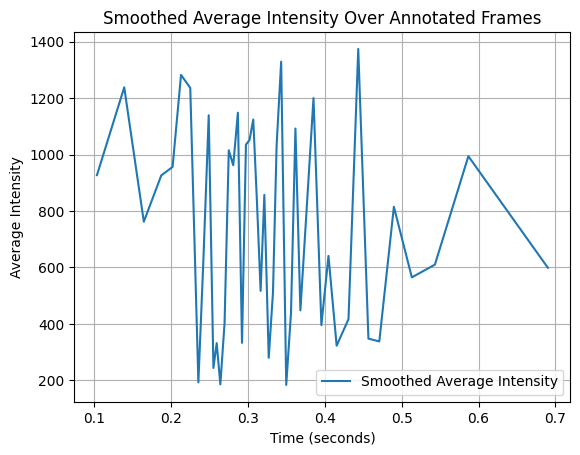

In [ ]:
import matplotlib.pyplot as plt
import pickle
import numpy as np

def calculate_intensity(valence, arousal):
    return np.sqrt(valence**2 + arousal**2)

def plot_smoothed_average_intensity(pickle_path, output_plot_path='smoothed_average_intensity_plot.png', frame_rate=25):
    # Load the pickle file
    with open(pickle_path, 'rb') as f:
        annotations = pickle.load(f)

    # Initialize lists to store frame indices and average intensities
    frame_indices = []
    average_intensities = []

    # Initialize variables for calculating the average
    cumulative_intensity = 0
    count = 0

    # Loop through each annotated frame
    for frame_id, frame_data in annotations.items():
        # Calculate average intensity of emotions for all faces
        face_intensities = [calculate_intensity(face['valence'], face['arousal'])
                            for k, face in frame_data.items() if k != 'frame_image']

        # Calculate and store the cumulative intensity for the frame
        if face_intensities:
            cumulative_intensity += np.mean(face_intensities)
            count += 1

        # Check if it's time to calculate the average for the past frames
        if count == frame_rate:
            avg_intensity = cumulative_intensity / frame_rate
            frame_indices.append(int(frame_id.split('_')[1]))  # Extract frame index
            average_intensities.append(avg_intensity)

            # Reset variables for the next set of frames
            cumulative_intensity = 0
            count = 0

    # Plot the smoothed average intensity over seconds
    plt.plot(average_intensities,frame_indices, label='Smoothed Average Intensity')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Average Intensity')
    plt.title('Smoothed Average Intensity Over Annotated Frames')
    plt.legend()
    plt.grid(True)

    # Save the plot to the specified output path
    plt.savefig(output_plot_path)
    plt.show()

# Example usage with frame_rate set to 25 (frames per second)
plot_smoothed_average_intensity('/content/drive/MyDrive/v1.pkl')
